In [1]:
import pycpt
import packaging
min_version = '2.6.1'
assert packaging.version.parse(pycpt.__version__) >= packaging.version.parse(min_version), f'This notebook requires version {min_version} or higher of the pycpt library, but you have version {pycpt.__version__}. Please close the notebook, update your environment, and load the notebook again. See https://iri-pycpt.github.io/installation/'

import cptdl as dl 
from cptextras import get_colors_bars
import datetime as dt
import numpy as np
import xarray as xr
import cptcore as cc
import scipy.ndimage as ndimage
import matplotlib.pyplot as plt
import pandas as pd
from dateutil.relativedelta import relativedelta
import cartopy.crs as ccrs
from sklearn.cross_decomposition import CCA, PLSCanonical, PLSSVD, PLSRegression
from sklearn.decomposition import PCA
import scipy as sp
from xmca.xarray import xMCA


# Load data

In [2]:
spi = xr.open_dataset('data/custom_spi_pearson3_3m.nc').fillna(0)
spi_detrended = xr.open_dataset('data/custom_spi_pearson3_3m_detrend.nc').fillna(0)

spi = spi.rename({'Y':'lat', 'X':'lon', 'T':'time', '__xarray_dataarray_variable__':'spi'}).sortby('time')
spi = spi.sel(lon=slice(32, 60))

spi_detrended = spi_detrended.rename({'Y':'lat', 'X':'lon', 'T':'time', '__xarray_dataarray_variable__':'spi'}).sortby('time')
spi_detrended = spi_detrended.sel(lon=slice(32, 60))



#NOAA COBE SST data
sst = xr.open_dataset('data/sst.mon.mean.nc').sortby('time')
sst['sst3m'] = sst['sst'] + sst['sst'].shift(time=1) + sst['sst'].shift(time=2)

#put lon is -180 to 180
sst = sst.assign_coords(lon=(((sst.lon + 180) % 360) - 180)).sortby('lon')
#match time periods
sst = sst.sel(time=slice(spi.time[0], spi.time[-1]), lat=slice(60, -60), lon=slice(-180, 180))
#merge spi and spi_detrended
spi = xr.merge([spi, spi_detrended.rename({'spi':'spi_detrended'})])


In [3]:

#match give same time period
spi = spi.sel(time=slice(sst.time[0], sst.time[-1])).transpose('time', 'lat', 'lon')
sst = sst.sel(time=slice(spi.time[0], spi.time[-1])).transpose('time', 'lat', 'lon')



In [4]:
# Function to detrend data along the time dimension
def detrend_xarray(data_array, dim):
    """
    Detrends the data along a specified dimension.

    Parameters:
        data_array (xarray.DataArray): The data to detrend.
        dim (str): The dimension along which to detrend.

    Returns:
        xarray.DataArray: The detrended data.
    """
    # Apply detrend along the specified dimension
    detrended = xr.apply_ufunc(
        sp.signal.detrend,
        data_array,
        input_core_dims=[[dim]],
        output_core_dims=[[dim]],
        vectorize=True,
        dask="parallelized",
        output_dtypes=[data_array.dtype]
    )
    return detrended

# Detrend the data month by month
sst_detrended_list = []
for month in range(1, 13):
    sst_data = sst['sst3m'].fillna(0)
    sst_month = sst_data.sel(time=sst_data['time.month'] == month)
    sst_detrended_month = detrend_xarray(sst_month, 'time')
    sst_detrended_list.append(sst_detrended_month)
sst_detrended = xr.concat(sst_detrended_list, dim='time').sortby('time')

sst["sst3m_detrended"] = sst_detrended.transpose('time', 'lat', 'lon')

    

# Total Period

## SVD

In [69]:
def svd_analysis(spi, sst, n_modes=3, month=None):
    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        month_num = months.index(month) + 1
        sst = sst.sel(time=sst['time.month'] == month_num)
        spi = spi.sel(time=spi['time.month'] == month_num)

    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)

    mca = xMCA(sst.fillna(0), spi.fillna(0))
    mca.solve()
    if month is not None:
        mca.set_field_names(f'SST ({month})', f'SPI ({month})')
    else:

        mca.set_field_names('SST', 'SPI')

    for i in range(n_modes):
        plt.figure(figsize=(8, 4))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())
        ax3 = plt.subplot(2,1,2)
        #ax3 = plt.subplot(2,1,2, projection=ccrs.PlateCarree())
        axes = [ax1, ax2,ax3]
        explained_var = mca.explained_variance()[i] /100
        ax = axes[0]
        mca.eofs()['left'].sel(mode=i+1).plot(ax=ax, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5,
                                                                                                                            'label': 'SST',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            'format':'%.2f'})
        ax.coastlines()
        ax.set_title(f"")
        #remove x and y labels
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax = axes[1]
        mca.eofs()['right'].sel(mode=i+1).plot(ax=ax, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5,
                                                                                                                            'label': 'SPI',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            'format':'%.2f'})
        ax.coastlines()
        ax.set_title(f"")
        #remove x and y labels
        ax.set_xlabel('')
        ax.set_ylabel('')
        left_pcs = mca.pcs()['left'].sel(mode=i+1)
        right_pcs = mca.pcs()['right'].sel(mode=i+1)
        ax = axes[2]
        left_pcs.plot(ax=ax, label='SST loadings', color='blue',alpha=0.5)
        right_pcs.plot(ax=ax, label='SPI loadings', color='red',alpha=0.5)
        ax.set_title(f"")
        ax.legend()
        correl_pcs = np.corrcoef(left_pcs.values, right_pcs.values)[0,1]
        if month is not None:
            plt.suptitle(f'SVD {month} - Mode {i+1}, Explained Variance: {explained_var:.1%}\nTime Series correl: {correl_pcs:.2f}', fontweight='bold')
        else:
            plt.suptitle(f'Mode {i+1} - Explained Variance: {explained_var:.1%}\nTime Series correl: {correl_pcs:.2f}', fontweight='bold')





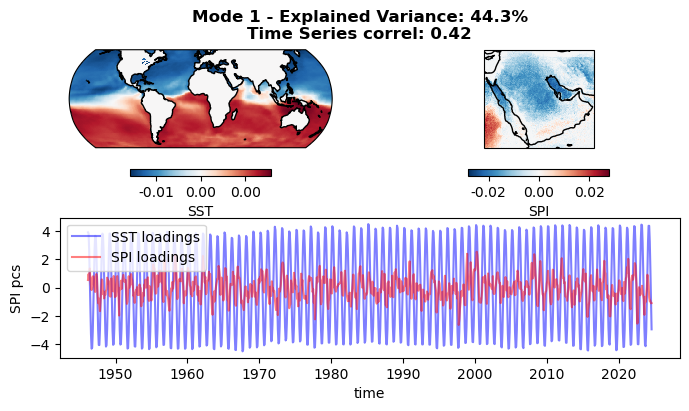

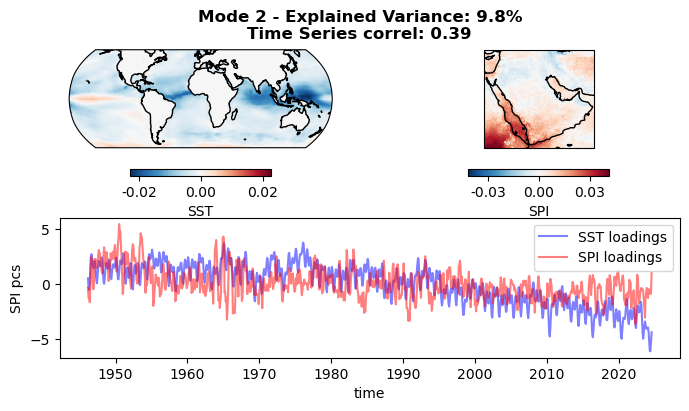

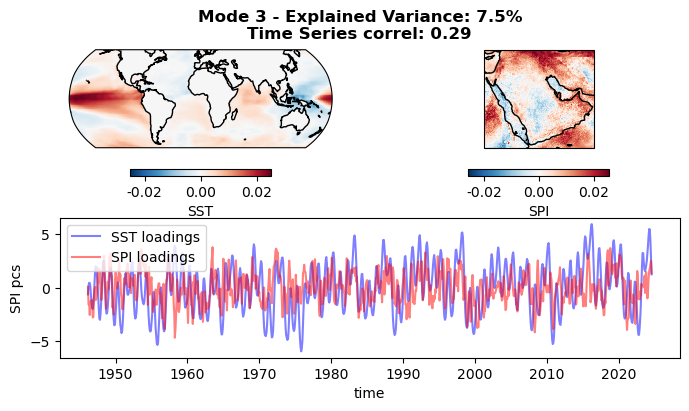

In [24]:
svd_analysis(spi.spi, sst.sst3m, n_modes=3)

In [8]:
class MCA:
    def __init__(self, X, Y,n_components=3):
        self.X = X
        self.Y = Y
        self.n_components = n_components
        self.fit()
        
    def fit(self):
        self.U, self.S, self.V = np.linalg.svd(self.X.T @ self.Y,full_matrices=True)
        self.U = self.U
        self.V = self.V
        self.S = self.S
        self.x_weights = self.U
        self.y_weights = self.V
        self.x_pcs = self.X @ self.x_weights
        self.y_pcs = self.Y @ self.y_weights

        self.skills = self.S**2 / np.sum(self.S**2)

In [40]:
sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)
spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)

mca = MCA(sst_2d, spi_2d)

In [41]:
mca.x_pcs.shape

(884, 3)

## PCA

In [84]:
def pca_analysis(spi, sst, n_components_spi=3, n_components_sst=3, month=None):

    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        month = months.index(month)+1
        spi = spi.sel(time=spi['time.month']==month)
        sst = sst.sel(time=sst['time.month']==month)
    
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)
    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)

    # Perform PCA and get components and explained variance ratios
    sst_2d = sst.fillna(0).values.reshape(sst.shape[0], -1)
    spi_2d = spi.fillna(0).values.reshape(spi.shape[0], -1)

    # sst_2d = (sst_2d - sst_2d.mean(axis=0)) / (sst_2d.std(axis=0)+1e-6)
    # spi_2d = (spi_2d - spi_2d.mean(axis=0)) / (spi_2d.std(axis=0)+1e-6)


    sst_pca = PCA(n_components=n_components_sst).fit(sst_2d)
    spi_pca = PCA(n_components=n_components_spi).fit(spi_2d)

    sst_pcs = sst_pca.transform(sst_2d)
    spi_pcs = spi_pca.transform(spi_2d)

    sst_weights = sst_pca.components_
    spi_weights = spi_pca.components_

    sst_explained_var = sst_pca.explained_variance_ratio_
    spi_explained_var = spi_pca.explained_variance_ratio_

    # Ensure the time values are properly formatted as datetime objects
    sst_times = pd.to_datetime(sst.time.values)
    spi_times = pd.to_datetime(spi.time.values)

    # Create dataframes for the PCs with datetime index
    sst_pcs_df = pd.DataFrame(sst_pcs, columns=[f'PC{i+1}' for i in range(3)], index=sst.time.values)
    spi_pcs_df = pd.DataFrame(spi_pcs, columns=[f'PC{i+1}' for i in range(3)], index=spi.time.values)


    for i in range(3):
        plt.figure(figsize=(6, 5))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())

        # Reshape the weights for sst and SPI to 2D maps (assuming original spatial dimensions)
        sst_reshaped = xr.DataArray(sst_weights[i].reshape(sst.shape[1], sst.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': sst.lat, 'lon': sst.lon})

        spi_reshaped = xr.DataArray(spi_weights[i].reshape(spi.shape[1], spi.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': spi.lat, 'lon': spi.lon})


        sst_reshaped.plot(ax=ax1, cmap='RdBu_r',add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.9,
                                                                                                                            'label': 'SST',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            #'format':'%.2f'
                                                                                                                            })
        ax1.coastlines()
        ax1.set_title(f"Explained Var: {sst_explained_var[i]:.1%}", fontweight='bold')


        spi_reshaped.plot(ax=ax2, transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, cbar_kwargs={'shrink': 0.7,
                                                                                                                            'label': 'SPI',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            #'format':'%.2f'
                                                                                                                            })
        ax2.coastlines()
        ax2.set_title(f"Explained Var: {spi_explained_var[i]:.1%}", fontweight='bold')

        if month is not None:
            plt.suptitle(f'PC{i+1}: {months[month-1]}',fontweight='bold')
        else:
            plt.suptitle(f'PC{i+1}',fontweight='bold')

        plt.show()


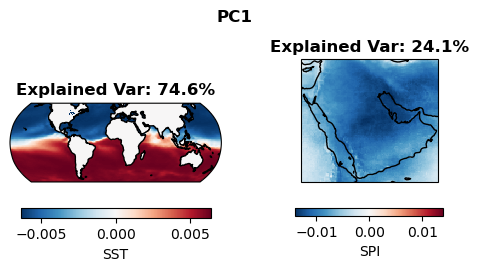

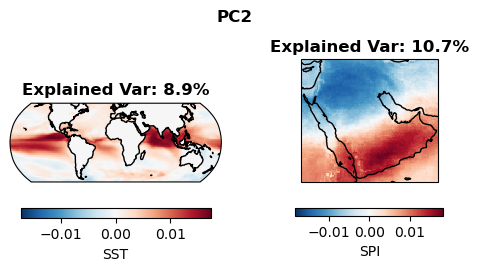

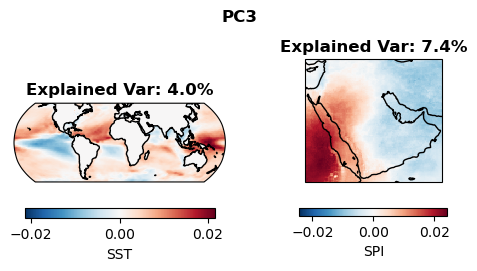

In [85]:
pca_analysis(spi.spi, sst.sst3m, 3, 3)

## CCA

In [107]:
def cca_analysis(spi, sst, n_components=3, month=None):

    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        num_month = months.index(month) + 1
        spi = spi.sel(time=spi.time.dt.month==num_month)
        sst = sst.sel(time=sst.time.dt.month==num_month)
    
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)
    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)
    

    spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)
    sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)

    # spi_2d = (spi_2d - spi_2d.mean(axis=0)) / (spi_2d.std(axis=0) + 1e-6)
    # sst_2d = (sst_2d - sst_2d.mean(axis=0)) / (sst_2d.std(axis=0) + 1e-6)


    cca = CCA(n_components=n_components)
    cca.fit(sst_2d, spi_2d)

    sst_cca, spi_cca = cca.transform(sst_2d, spi_2d)

    # Create dataframes for the CCA components with datetime index
    sst_cca_df = pd.DataFrame(sst_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)
    spi_cca_df = pd.DataFrame(spi_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)

    for i in range(3):
        plt.figure(figsize=(6, 5))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())
        
        # Reshape the weights for sst and SPI to 2D maps (assuming original spatial dimensions)
        sst_reshaped = xr.DataArray(cca.x_loadings_[:, i].reshape(sst.sst.shape[1], sst.sst.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': sst.lat, 'lon': sst.lon})

        spi_reshaped = xr.DataArray(cca.y_loadings_[:, i].reshape(spi.spi.shape[1], spi.spi.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': spi.lat, 'lon': spi.lon})


        sst_reshaped.plot(ax=ax1, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5, 'label': 'SST',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'}
                    )
        ax1.coastlines()
        ax1.set_title(f"")

        spi_reshaped.plot(ax=ax2, transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, cbar_kwargs={'shrink': 0.5, 'label': 'SPI',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'}
                    )
        ax2.coastlines()
        ax2.set_title(f"")

        if month is not None:
            plt.suptitle(f"CCA Mode {i+1} {month}", fontweight='bold')
        else:
            plt.suptitle(f"CCA Mode {i+1}", fontweight='bold')
    
        plt.show()



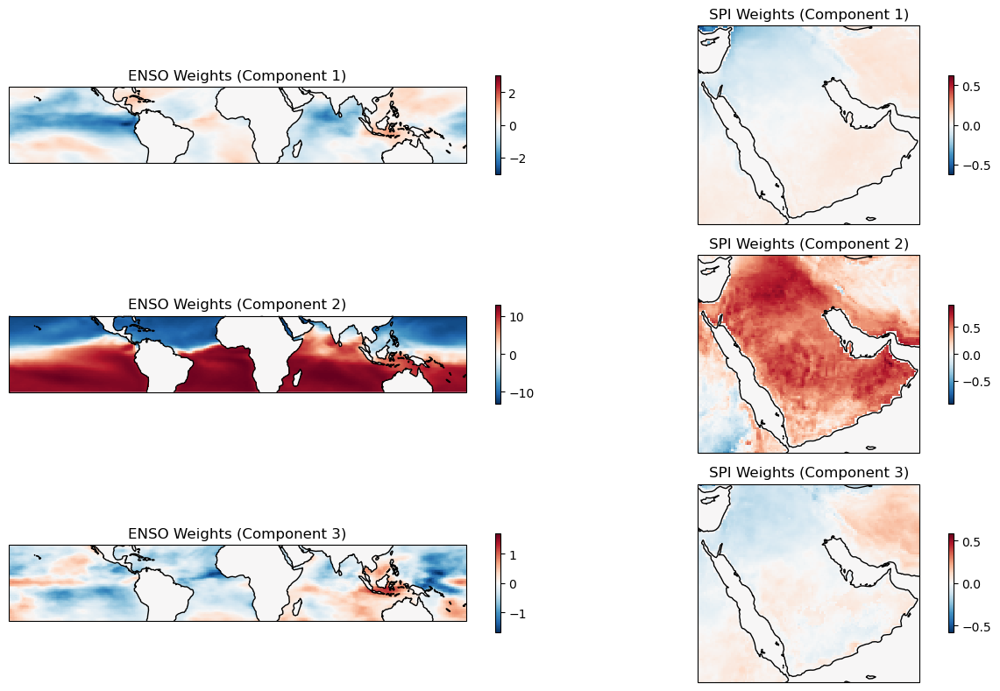

In [73]:
cca_analysis(spi, sst, 3)

## Denoised CCA

In [112]:
def denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=10, n_pcs_spi=10, month=None):

    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        num_month = months.index(month) + 1
        spi = spi.sel(time=spi.time.dt.month==num_month)
        sst = sst.sel(time=sst.time.dt.month==num_month)
    
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)
    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)
    
    spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)
    sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)

    # spi_2d = (spi_2d - spi_2d.mean(axis=0)) / (spi_2d.std(axis=0) + 1e-6)
    # sst_2d = (sst_2d - sst_2d.mean(axis=0)) / (sst_2d.std(axis=0) + 1e-6)

    pca_sst = PCA(n_components=n_pcs_sst).fit(sst_2d)
    pca_spi = PCA(n_components=n_pcs_spi).fit(spi_2d)


    sst_pcs = pca_sst.transform(sst_2d) 
    spi_pcs = pca_spi.transform(spi_2d) 

    sst_denoised = pca_sst.inverse_transform(sst_pcs) 
    spi_denoised = pca_spi.inverse_transform(spi_pcs)   

    # sst_denoised = (sst_denoised - sst_denoised.mean(axis=0)) / (sst_denoised.std(axis=0) + 1e-6)
    # spi_denoised = (spi_denoised - spi_denoised.mean(axis=0)) / (spi_denoised.std(axis=0) + 1e-6)


    cca = CCA(n_components=n_components_cca)
    cca.fit(sst_denoised, spi_denoised)

    sst_cca, spi_cca = cca.transform(sst_denoised, spi_denoised)

    # Create dataframes for the CCA components with datetime index
    sst_cca_df = pd.DataFrame(sst_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)
    spi_cca_df = pd.DataFrame(spi_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)


    for i in range(3):
        plt.figure(figsize=(6, 5))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())
        
        # Reshape the weights for sst and SPI to 2D maps (assuming original spatial dimensions)
        sst_reshaped = xr.DataArray(cca.x_loadings_[:, i].reshape(sst.sst.shape[1], sst.sst.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': sst.lat, 'lon': sst.lon})

        spi_reshaped = xr.DataArray(cca.y_loadings_[:, i].reshape(spi.spi.shape[1], spi.spi.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': spi.lat, 'lon': spi.lon})


        sst_reshaped.plot(ax=ax1, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5, 'label': 'SST',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'})
        ax1.coastlines()
        ax1.set_title(f"")

        spi_reshaped.plot(ax=ax2, transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, cbar_kwargs={'shrink': 0.5, 'label': 'SPI',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'})
        ax2.coastlines()
        ax2.set_title(f"")

        if month is not None:
            plt.suptitle(f"CCA Mode {i+1} {month}", fontweight='bold')
        else:
            plt.suptitle(f"CCA Mode {i+1}", fontweight='bold')
    
        plt.show()

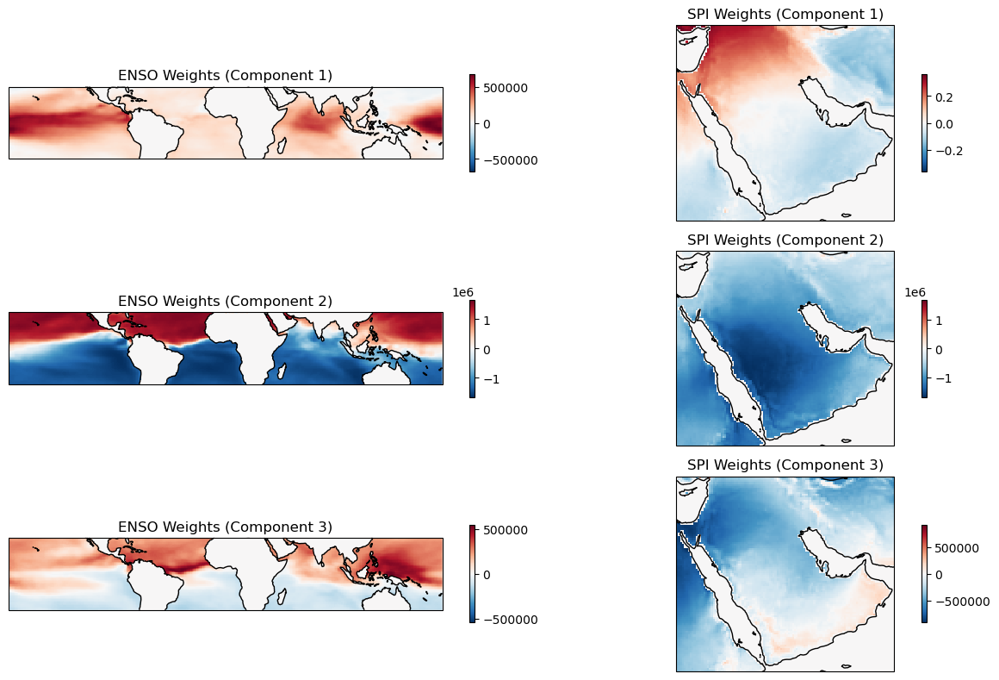

In [65]:
denoised_cca_analysis(spi, sst)

In [17]:
spi_cpt = spi.spi.fillna(0).rename({'time':'T', 'lat':'Y', 'lon':'X'}).transpose('T', 'Y', 'X')
#start from 1981
spi_cpt = spi_cpt.sel(T=slice('1981-01-01', '2024-12-01'))

spi_cpt.attrs['units'] = 'unitless'
spi_cpt.attrs['missing'] = '-999'
spi_cpt.attrs['nrows'] = spi_cpt.shape[1]
spi_cpt.attrs['ncols'] = spi_cpt.shape[2]
spi_cpt.attrs['row'] = 'Y'
spi_cpt.attrs['col'] = 'X'
spi_cpt.attrs['standard_name'] = 'SPI'

sst_cpt = sst.sst.fillna(0).isel(time=slice(None,-1)).rename({'time':'T', 'lat':'Y', 'lon':'X'}).transpose('T', 'Y', 'X')
sst_cpt = sst_cpt.sel(T=slice('1981-01-01', '2024-12-01'))
sst_cpt.attrs['units'] = 'celsius'
sst_cpt.attrs['missing'] = '999'
sst_cpt.attrs['nrows'] = sst_cpt.shape[1]
sst_cpt.attrs['ncols'] = sst_cpt.shape[2]
sst_cpt.attrs['row'] = 'Y'
sst_cpt.attrs['col'] = 'X'
sst_cpt.attrs['standard_name'] = 'SST'

hindcasts, forecasts, skills, patterns_x, patterns_y = cc.canonical_correlation_analysis(sst_cpt, spi_cpt)

CPTError: 
PROCESS STATUS: ALIVE (WILL BE STOPPED)
  last command: 'C:\Users\emile\.pycpt_workspace\3bd7446b-82d0-4a5f-a872-d9a7ee2db0a3\original_predictor'
  last message:'Error
  
 ERROR:  Unable to open monthly X files
 CPT '


# Monthly

## SVD

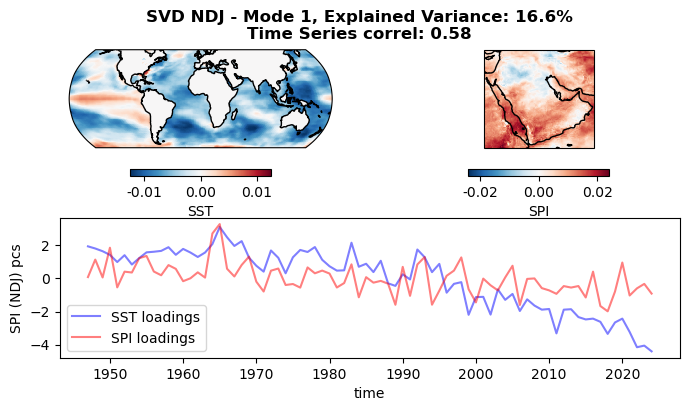

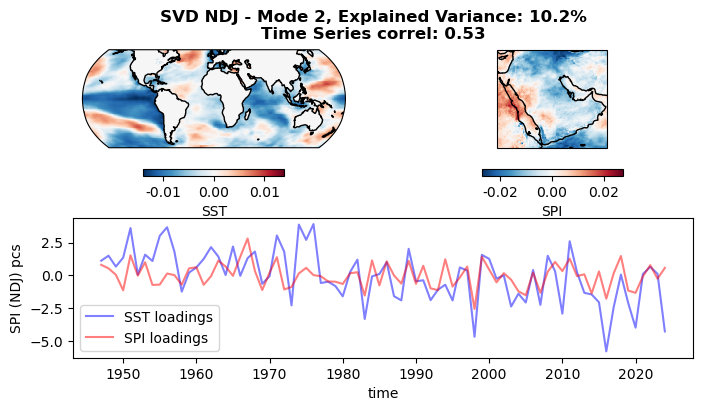

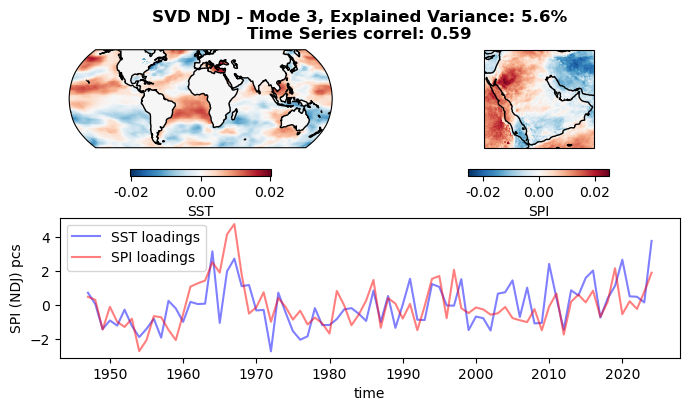

In [28]:
svd_analysis(spi.spi, sst.sst3m, n_modes=3, month='NDJ')

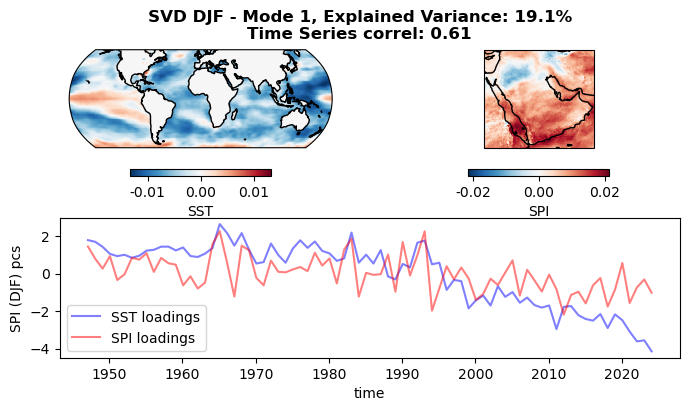

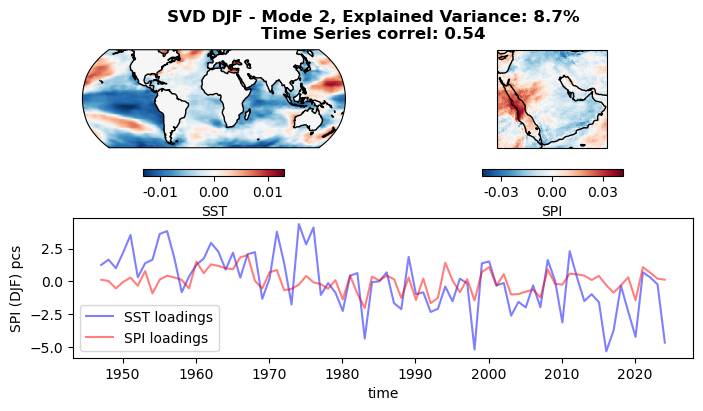

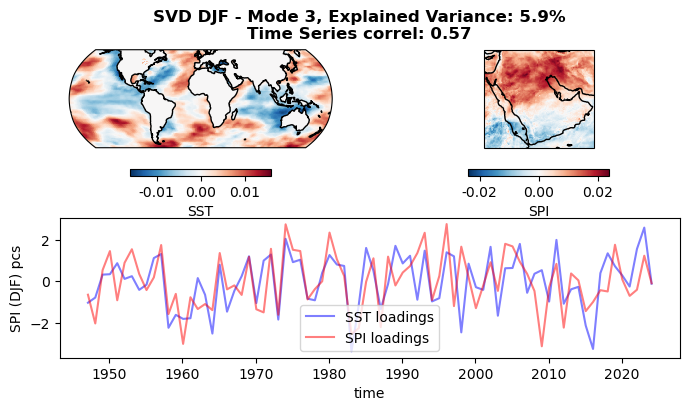

In [29]:
svd_analysis(spi.spi, sst.sst3m, month='DJF')

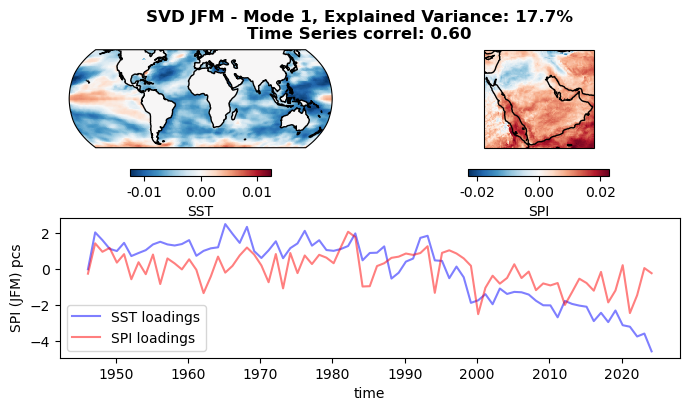

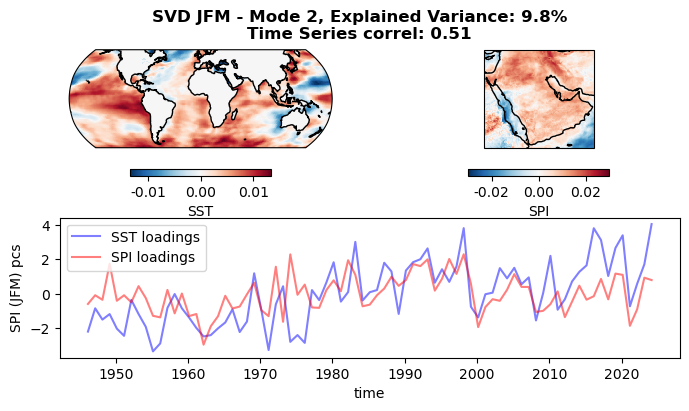

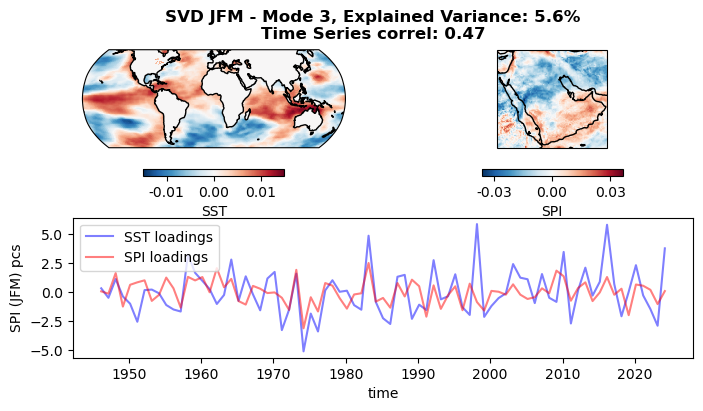

In [30]:
svd_analysis(spi.spi, sst.sst3m, month='JFM')

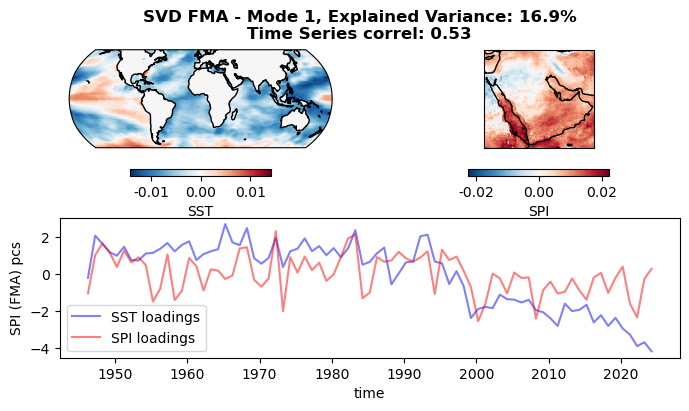

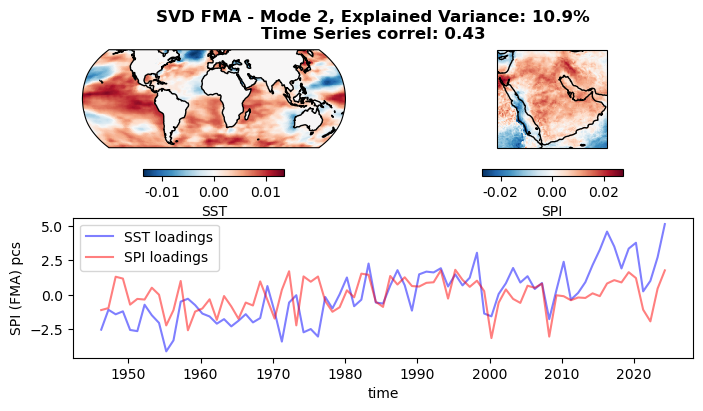

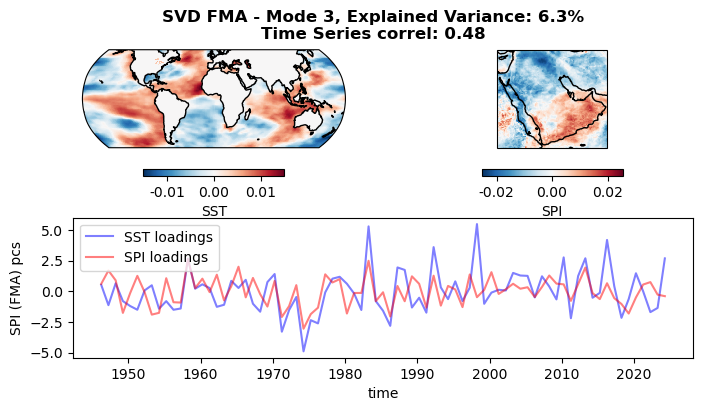

In [31]:
svd_analysis(spi.spi, sst.sst3m, month='FMA')

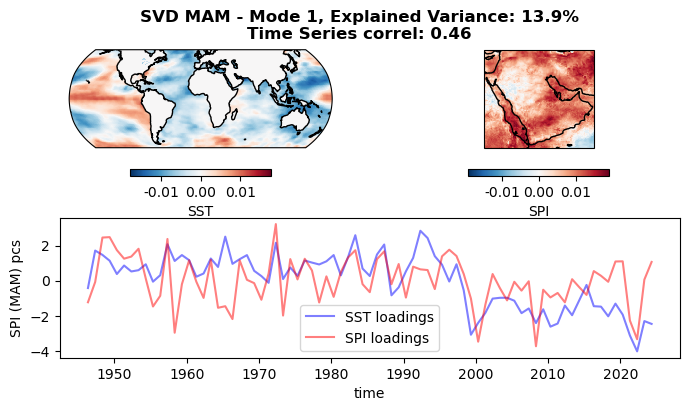

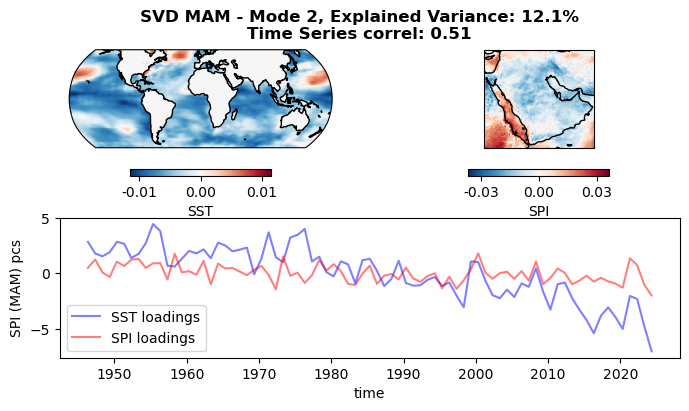

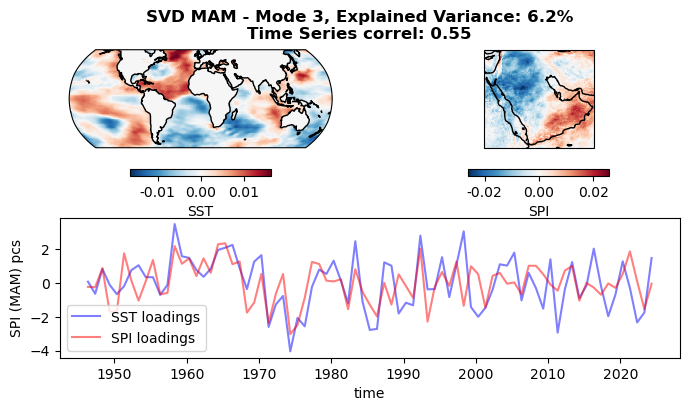

In [32]:
svd_analysis(spi.spi,sst.sst3m, month='MAM')

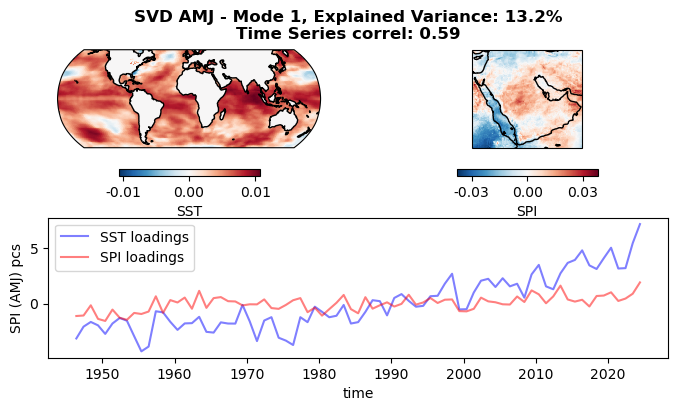

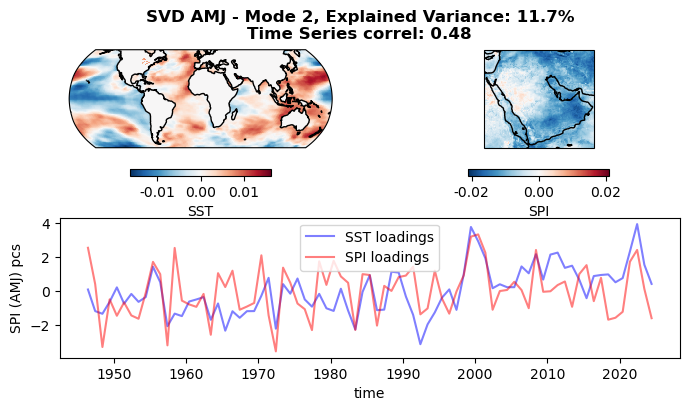

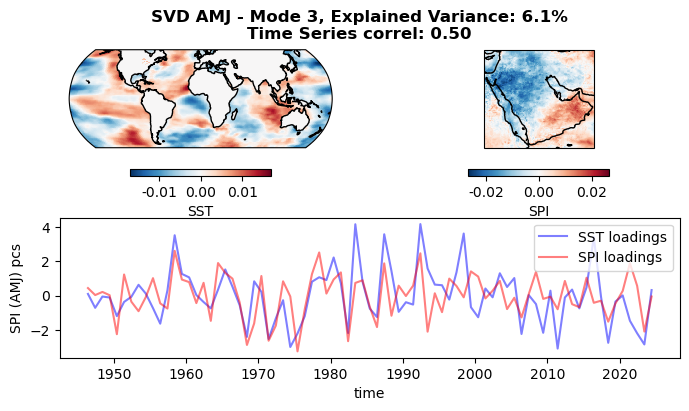

In [33]:
svd_analysis(spi.spi,sst.sst3m, month='AMJ')

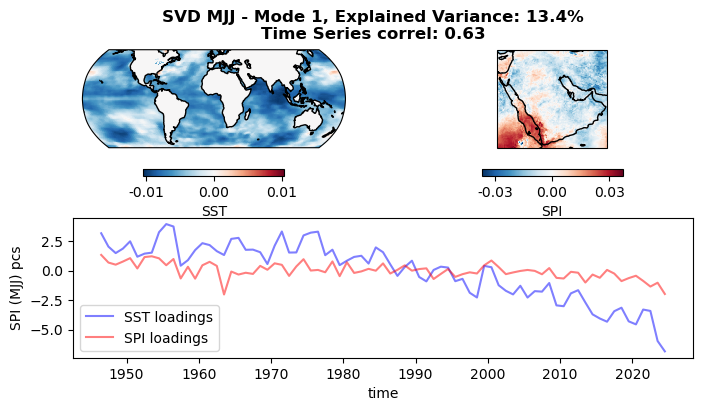

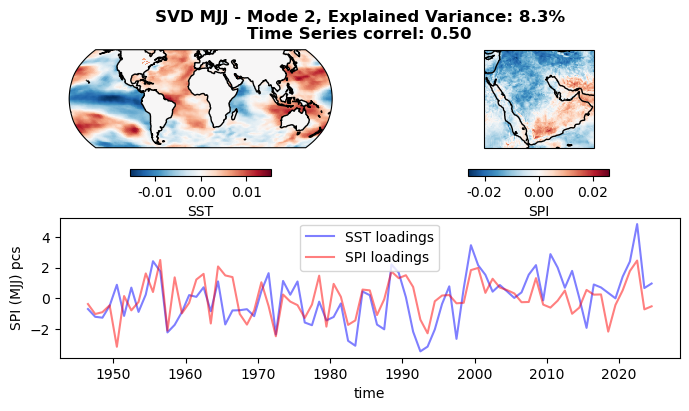

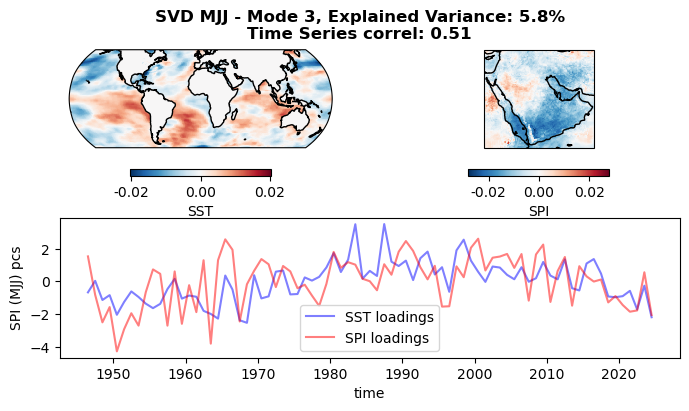

In [34]:
svd_analysis(spi.spi,sst.sst3m, month='MJJ')

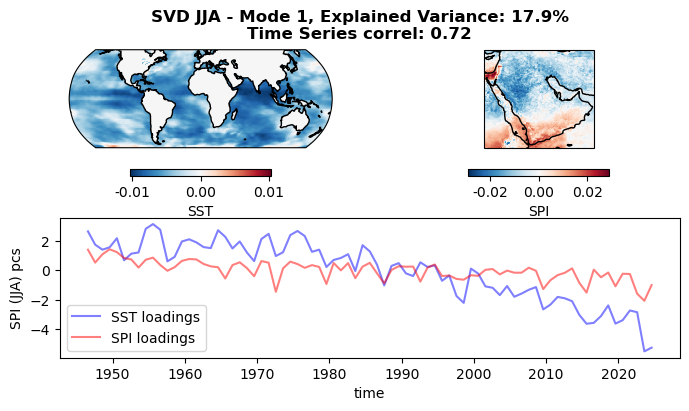

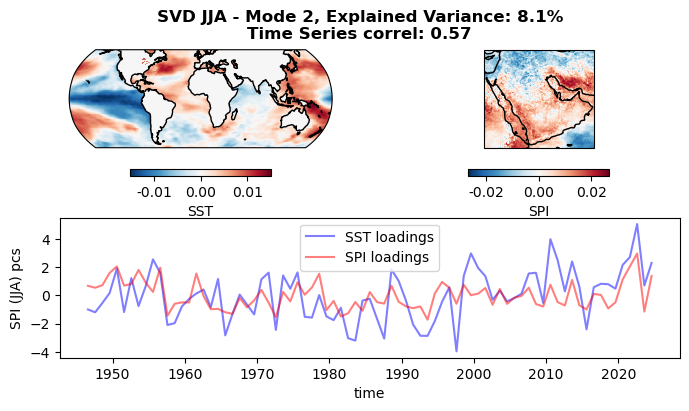

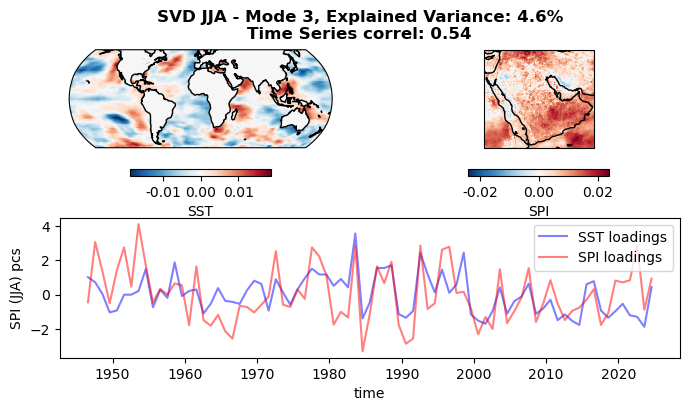

In [35]:
svd_analysis(spi.spi,sst.sst3m, month='JJA')

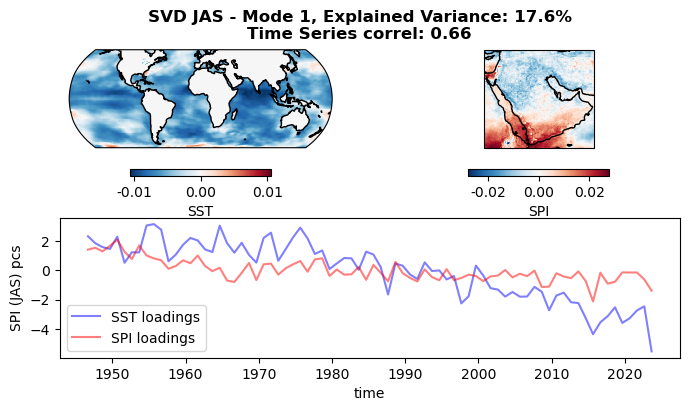

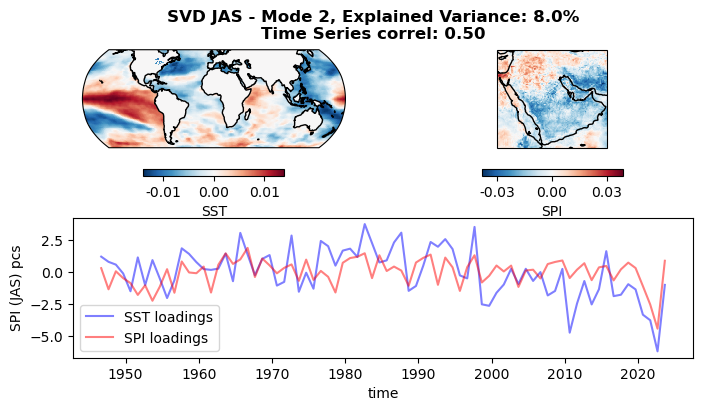

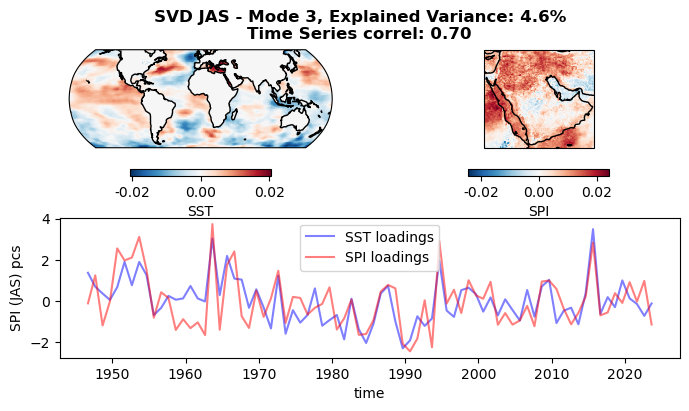

In [36]:
svd_analysis(spi.spi,sst.sst3m, month='JAS')

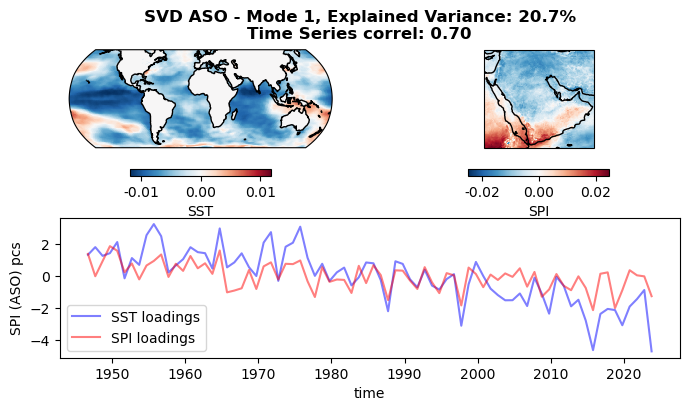

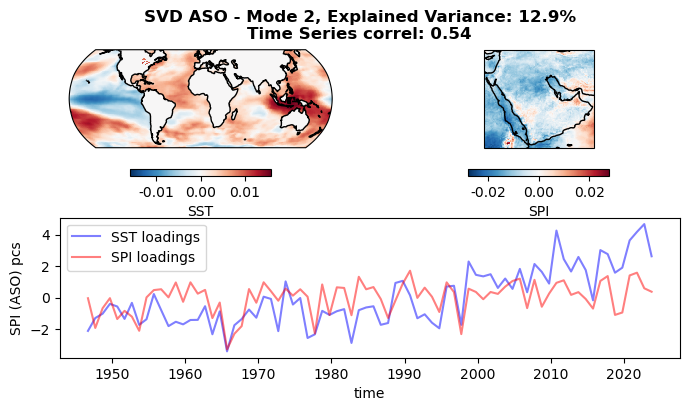

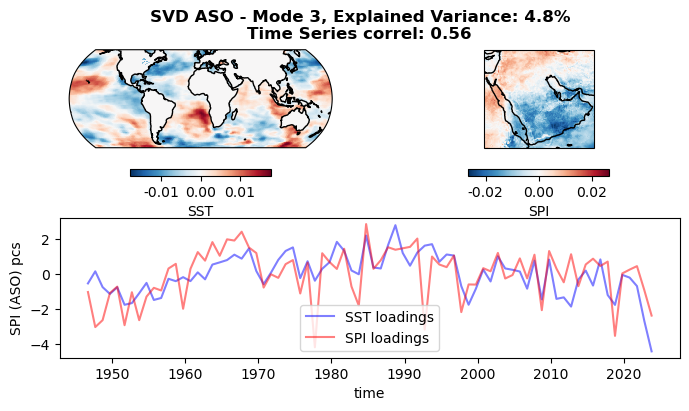

In [37]:
svd_analysis(spi.spi,sst.sst3m, month='ASO')

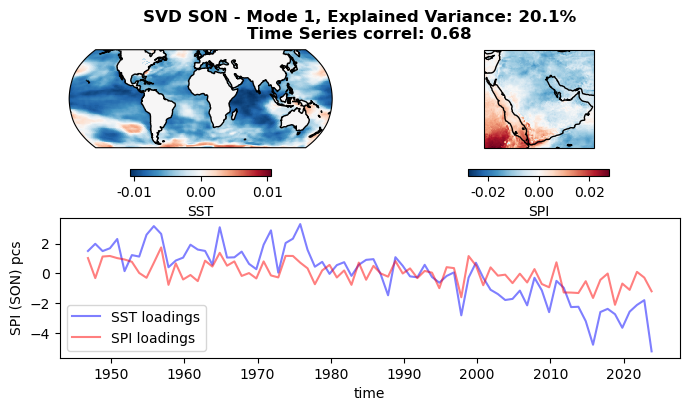

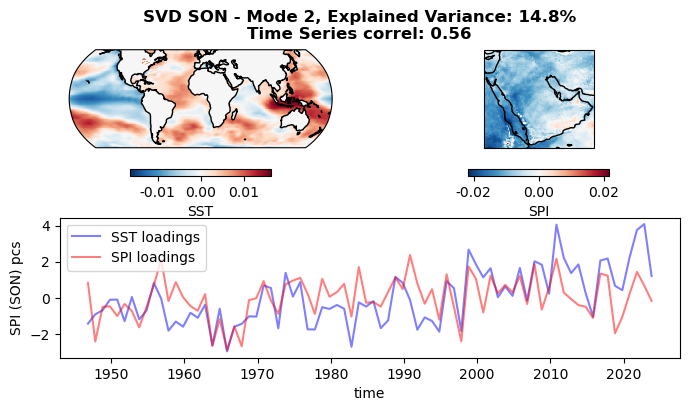

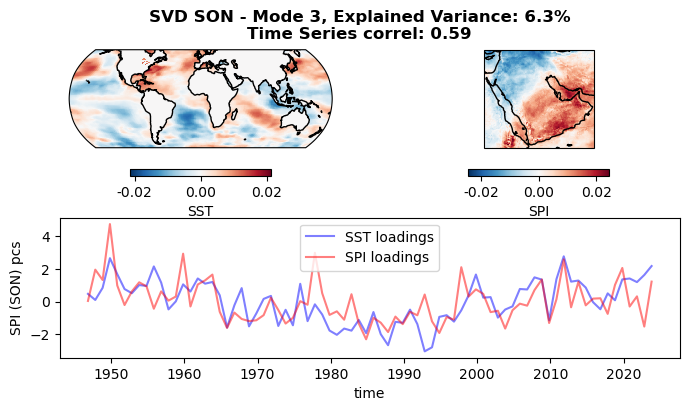

In [38]:
svd_analysis(spi.spi,sst.sst3m, month='SON')

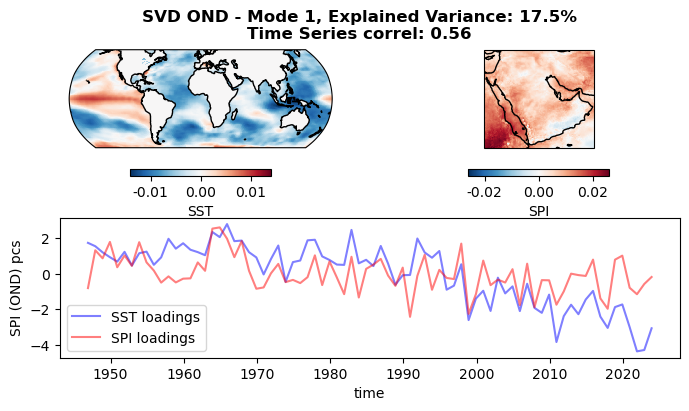

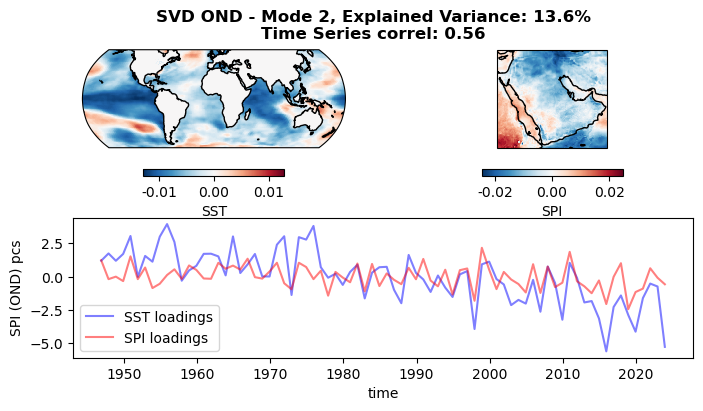

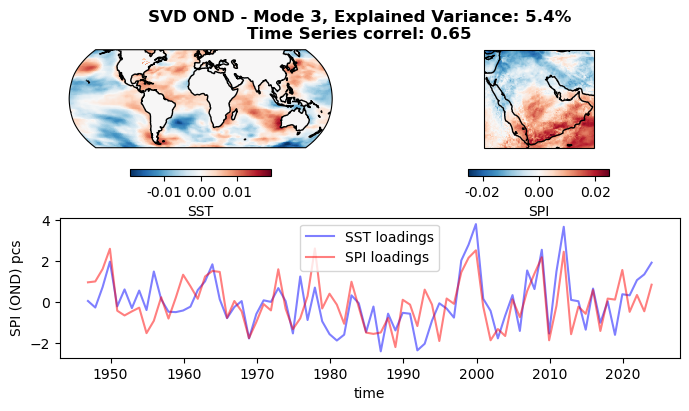

In [39]:
svd_analysis(spi.spi,sst.sst3m, month='OND')

### Detrended

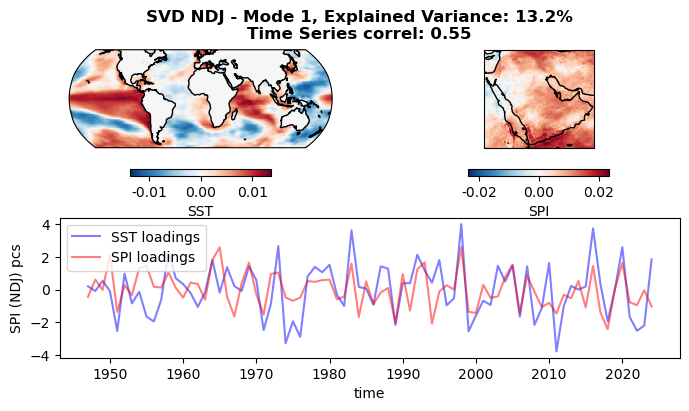

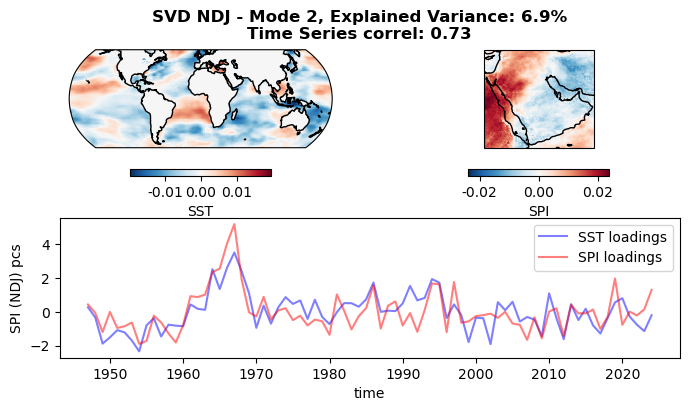

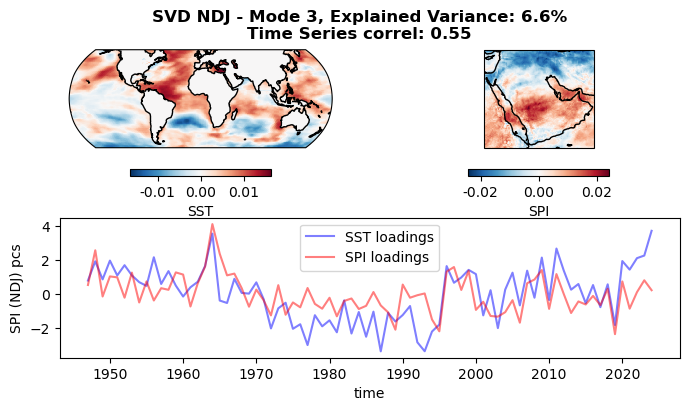

In [134]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='NDJ')

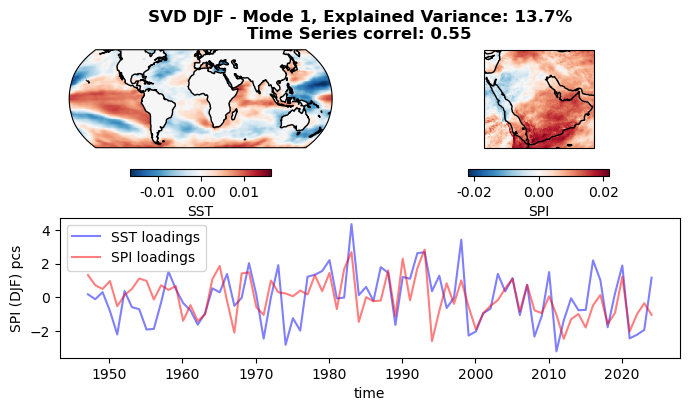

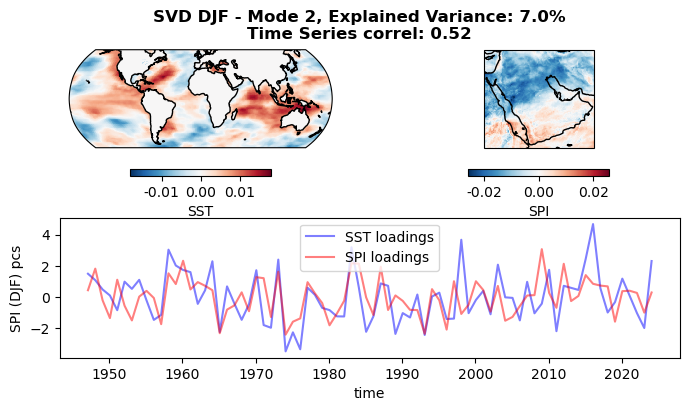

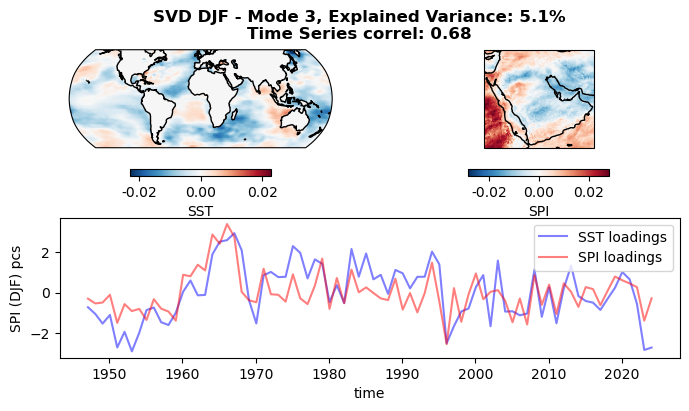

In [135]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='DJF')

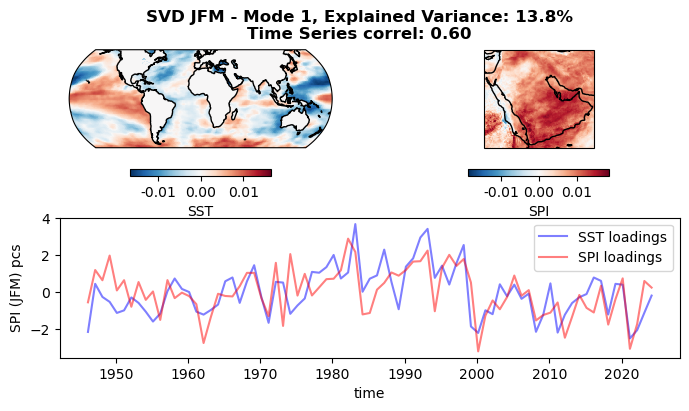

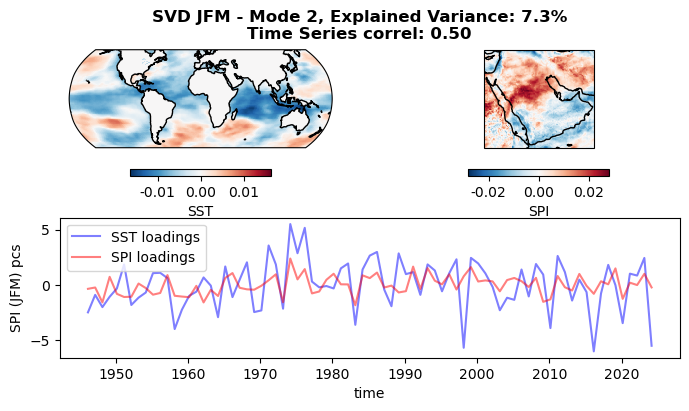

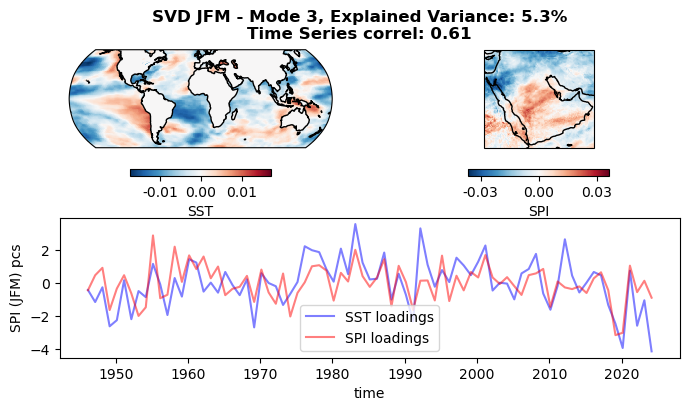

In [136]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='JFM')

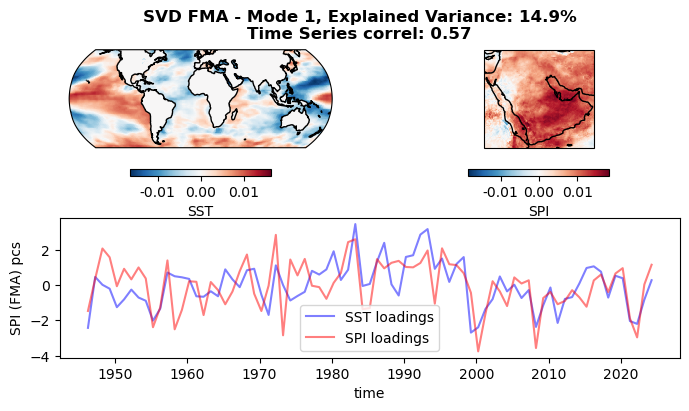

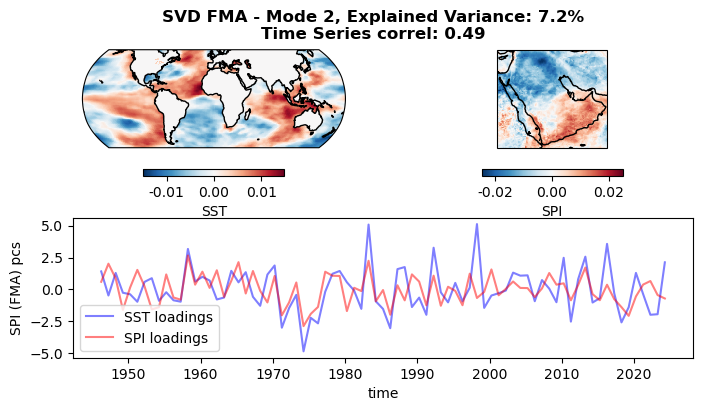

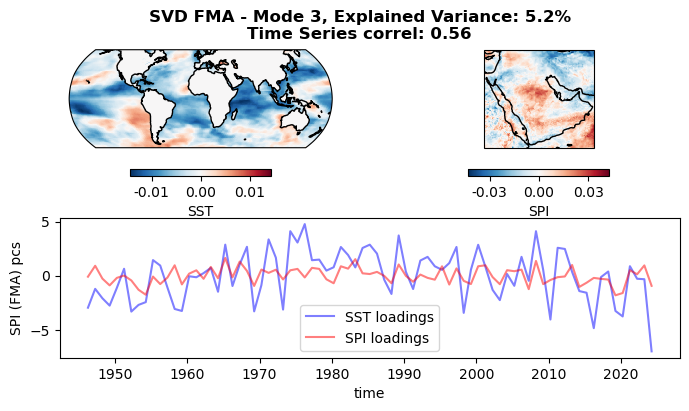

In [137]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='FMA')

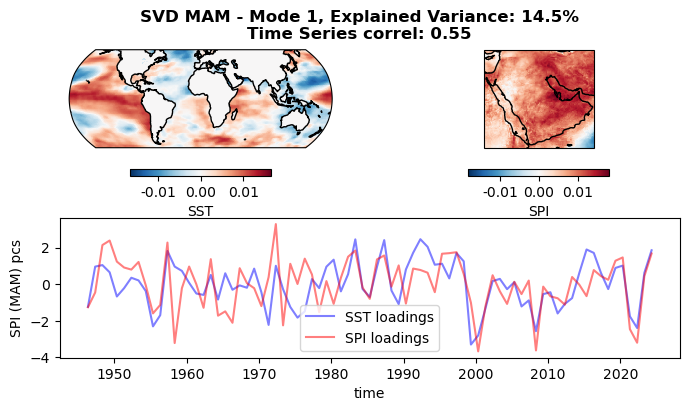

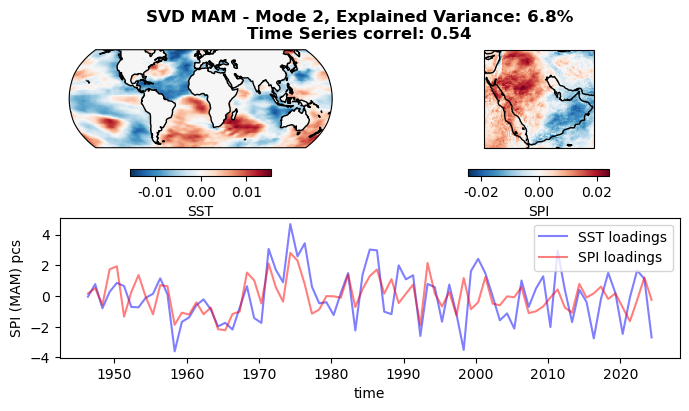

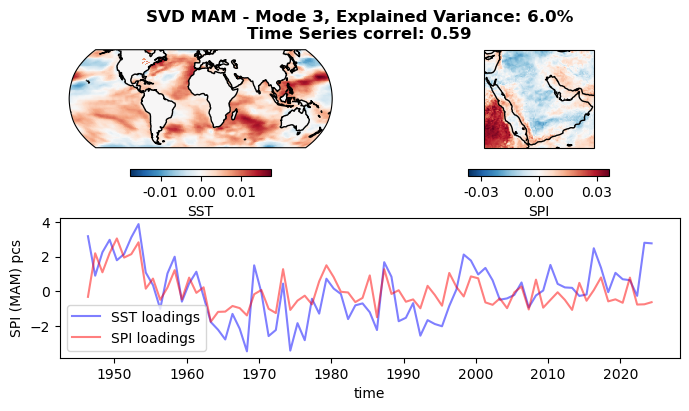

In [138]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='MAM')

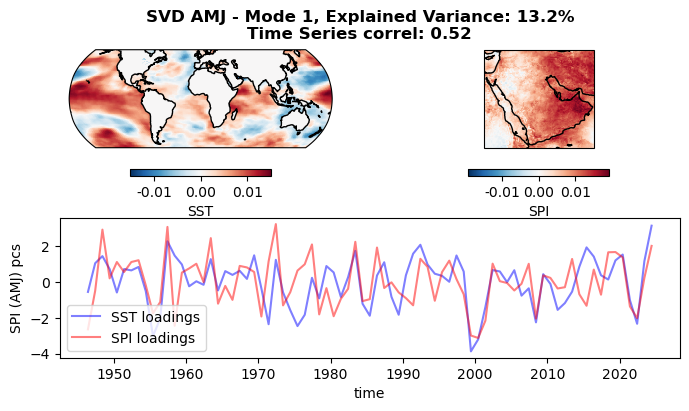

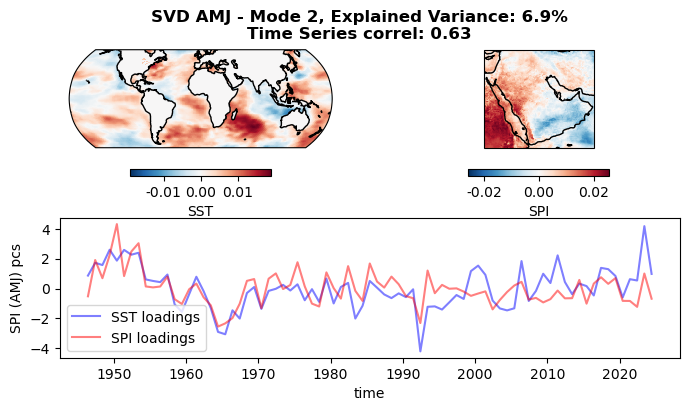

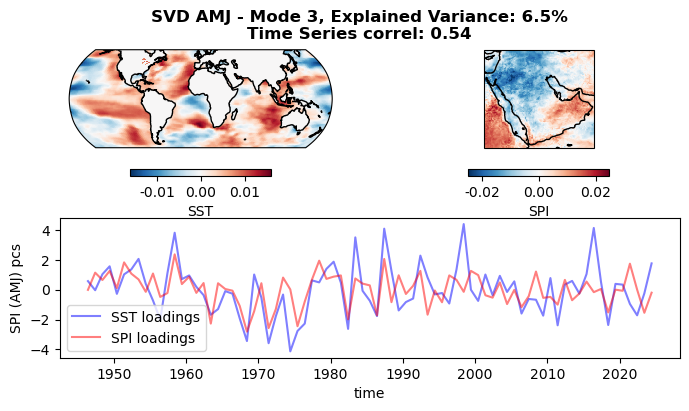

In [139]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='AMJ')

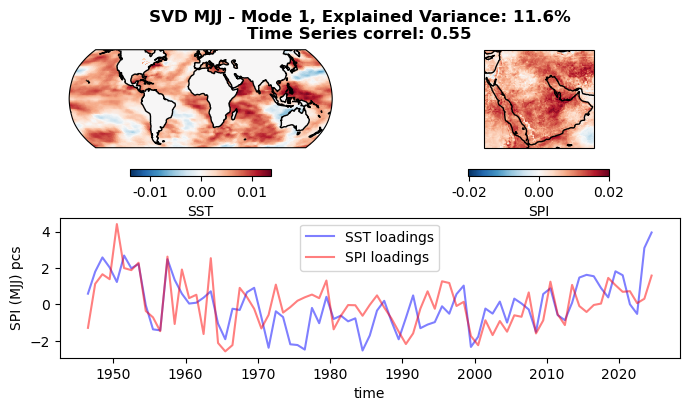

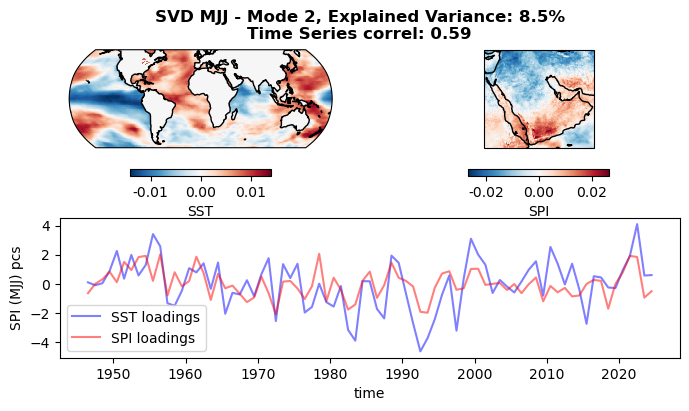

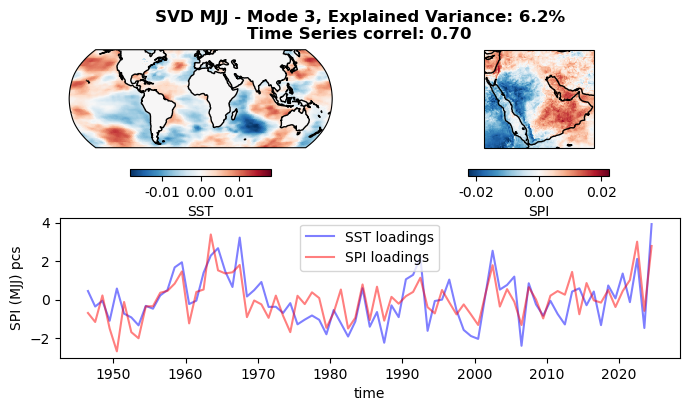

In [140]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='MJJ')

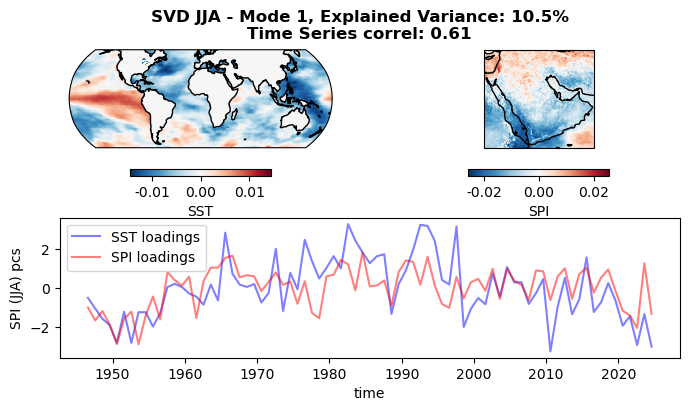

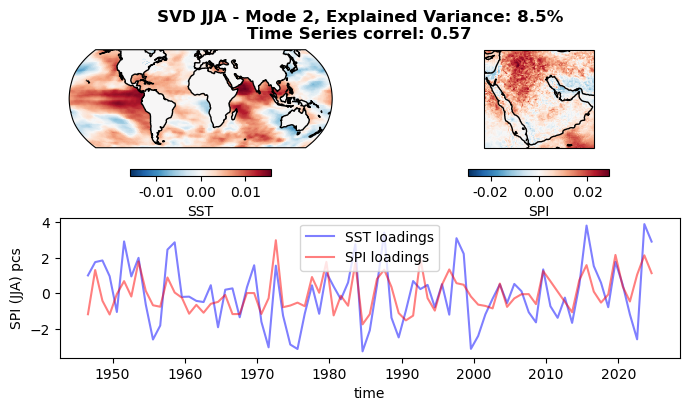

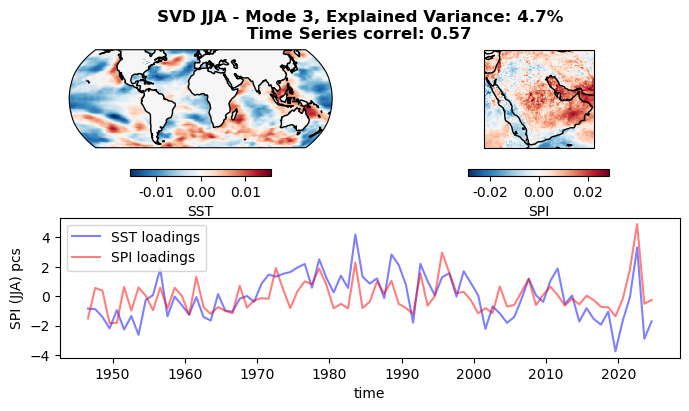

In [141]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='JJA')

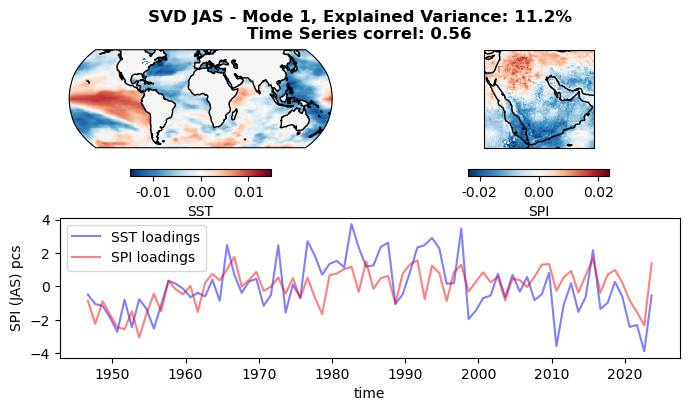

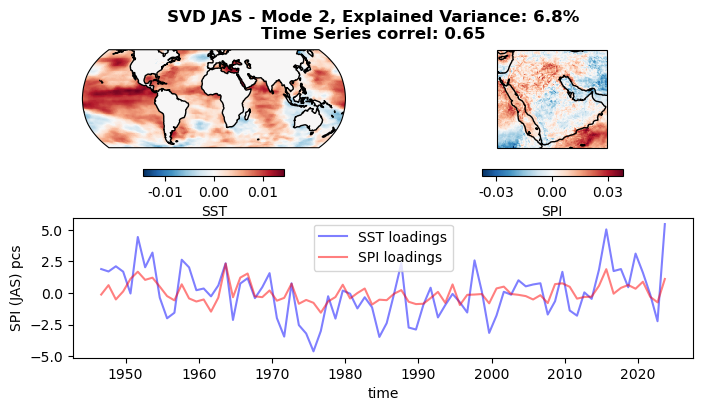

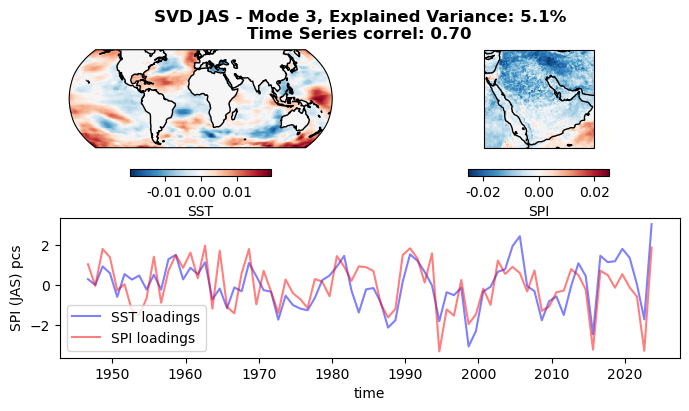

In [142]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='JAS')

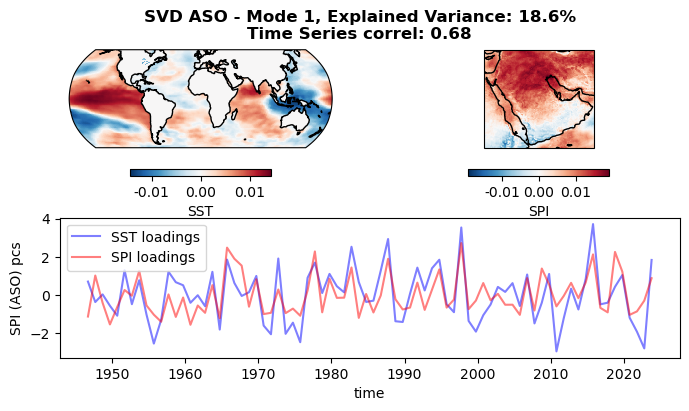

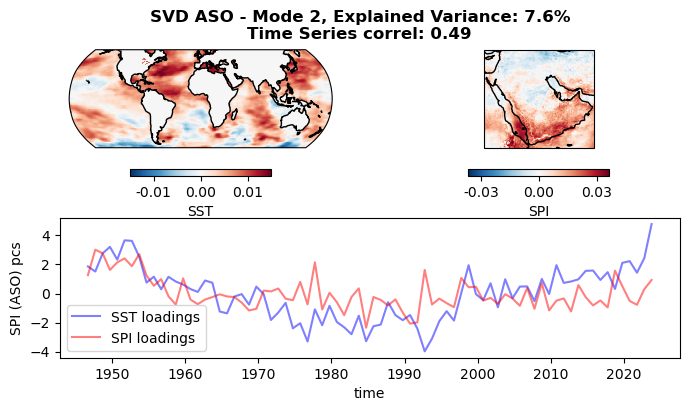

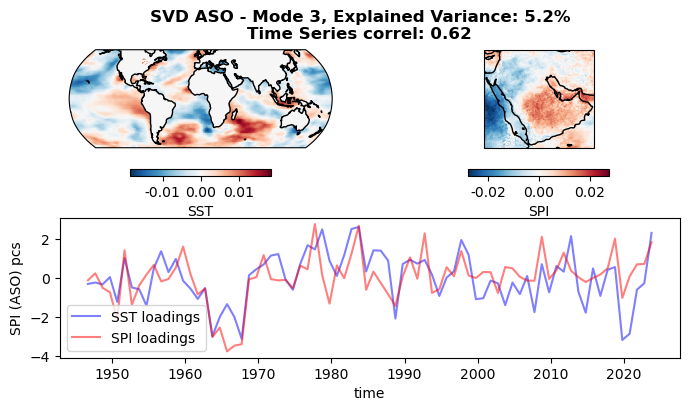

In [143]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='ASO')

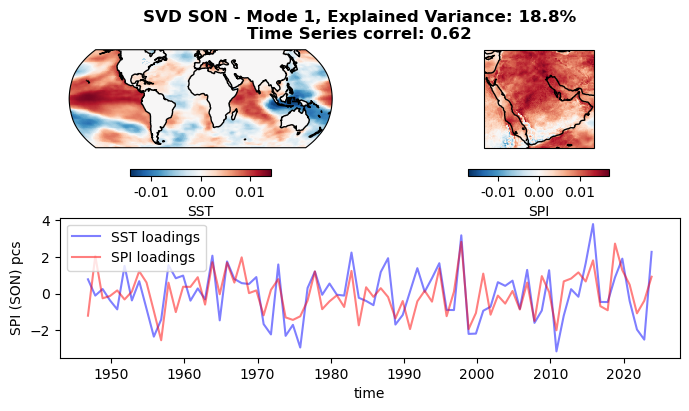

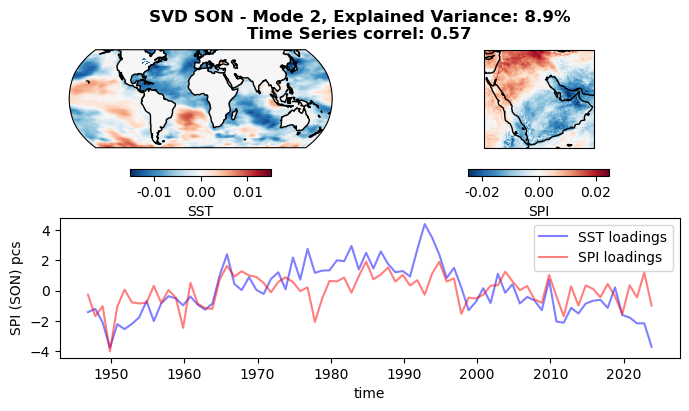

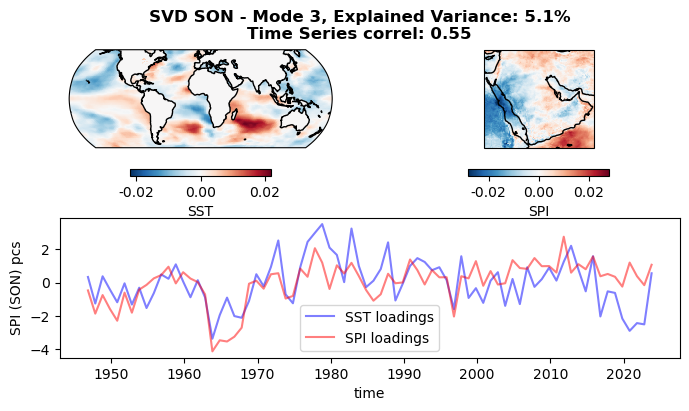

In [144]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='SON')

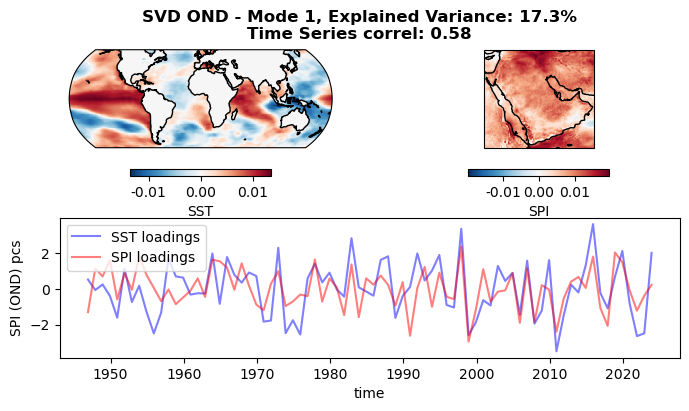

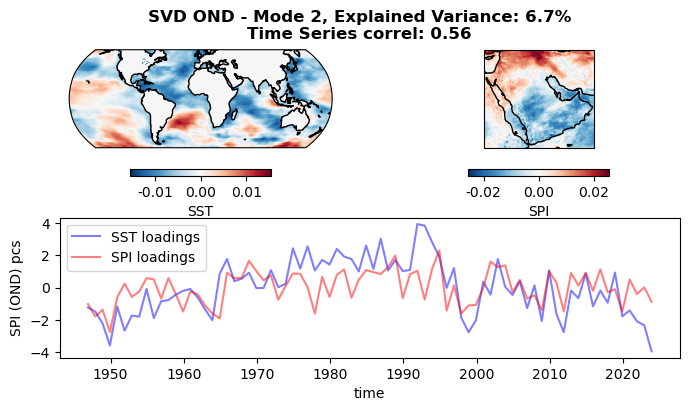

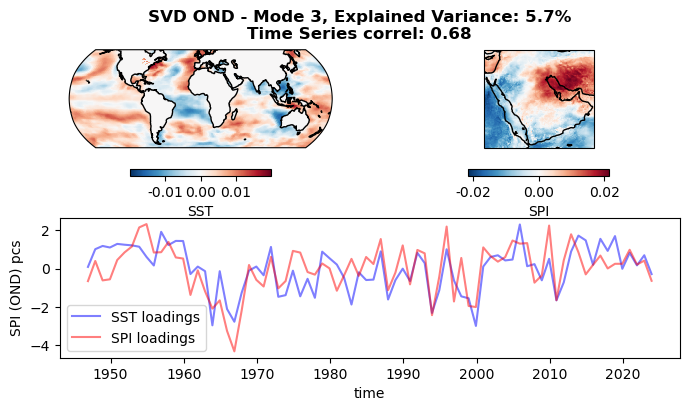

In [145]:
svd_analysis(spi.spi_detrended, sst.sst3m_detrended, n_modes=3, month='OND')

## PCA

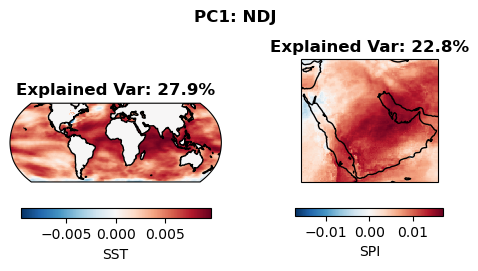

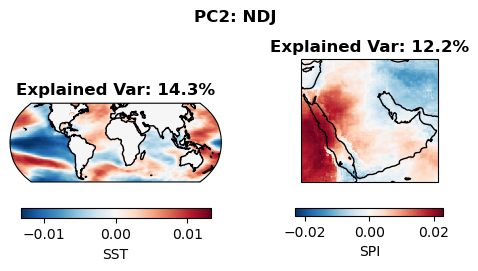

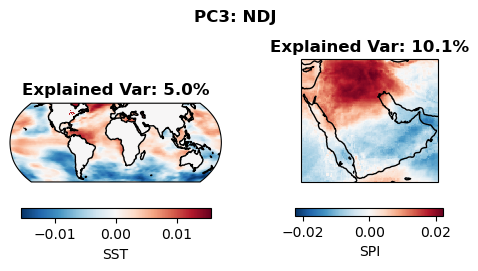

In [86]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='NDJ')

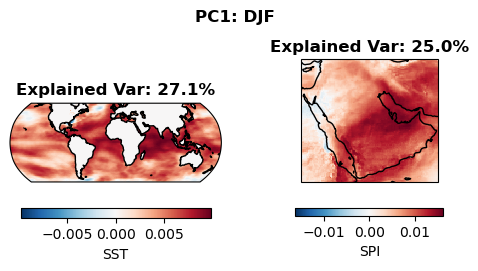

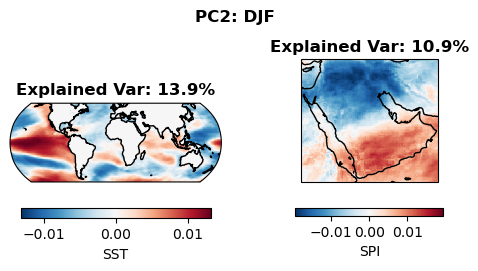

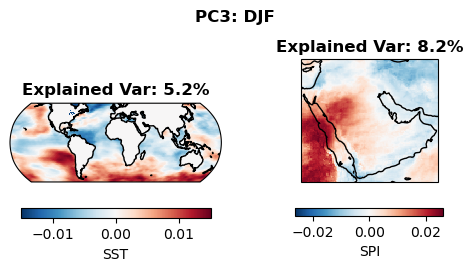

In [87]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='DJF')

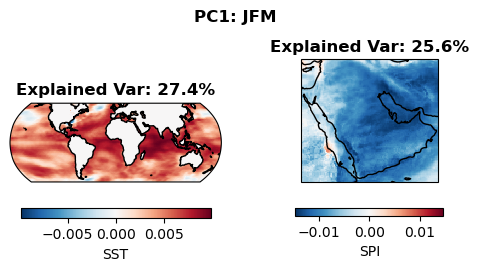

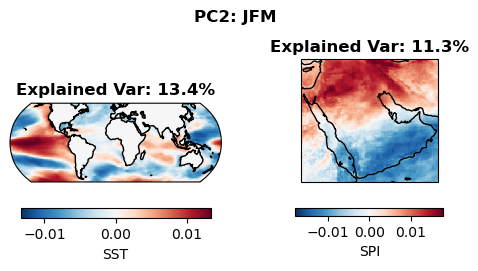

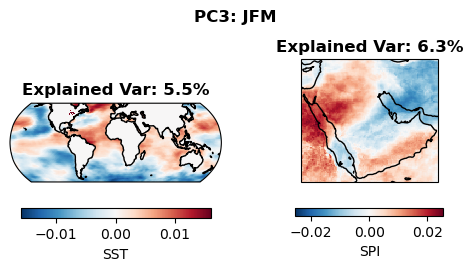

In [88]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='JFM')

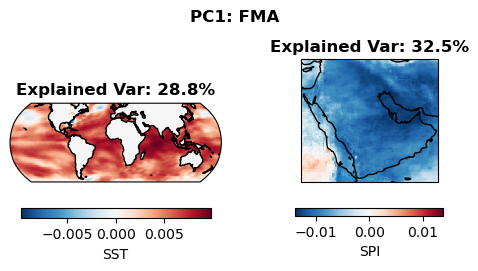

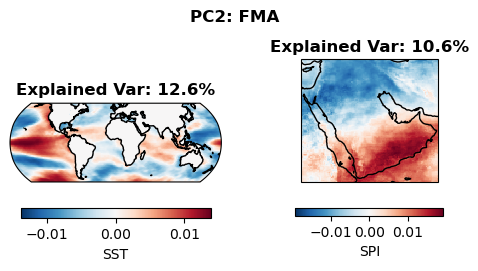

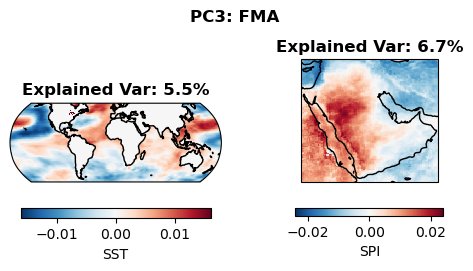

In [89]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='FMA')

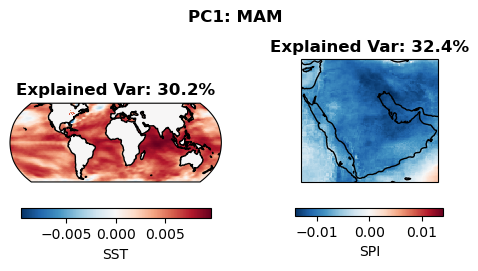

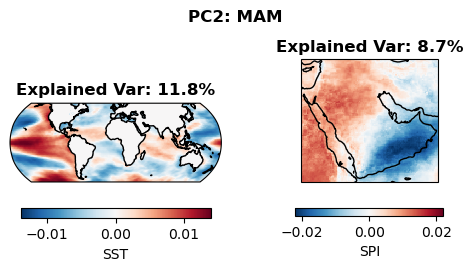

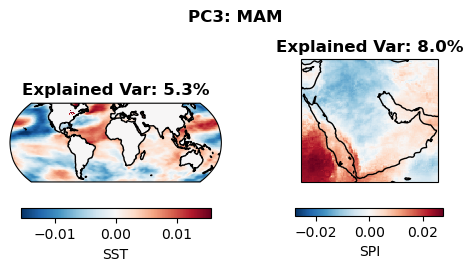

In [90]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='MAM')

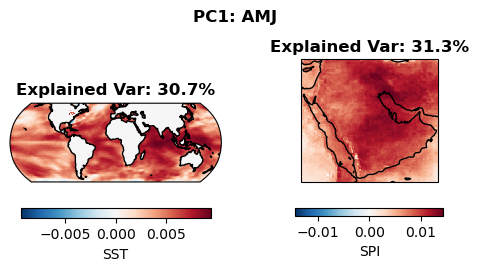

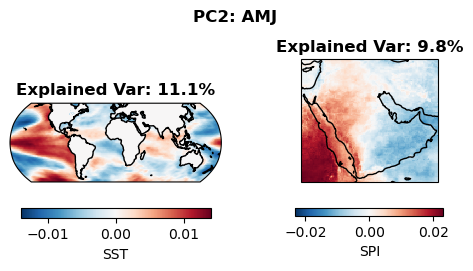

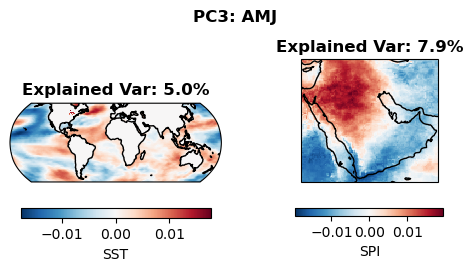

In [91]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='AMJ')

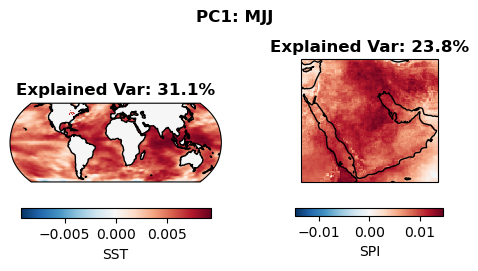

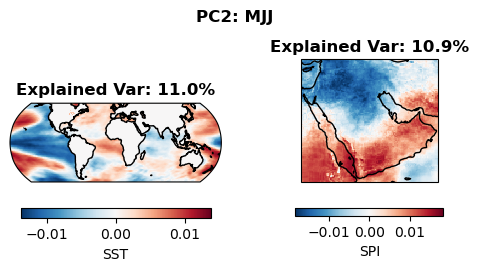

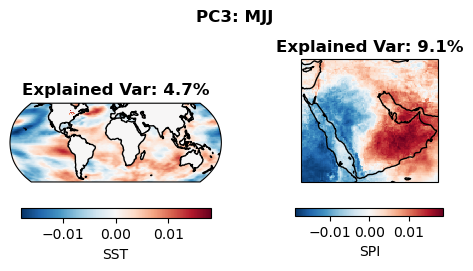

In [92]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='MJJ')

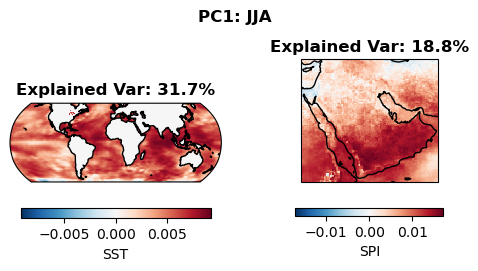

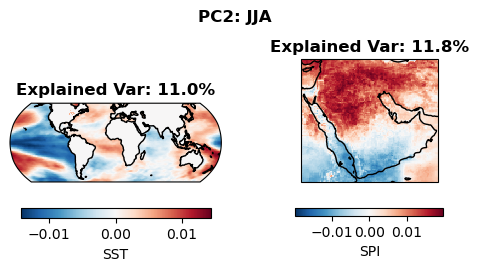

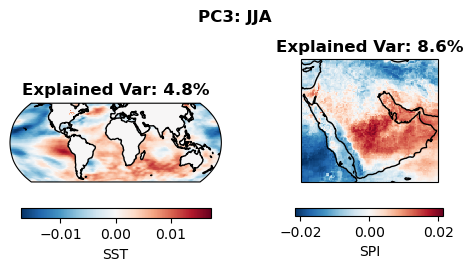

In [93]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='JJA')

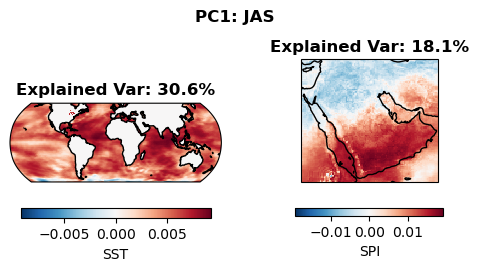

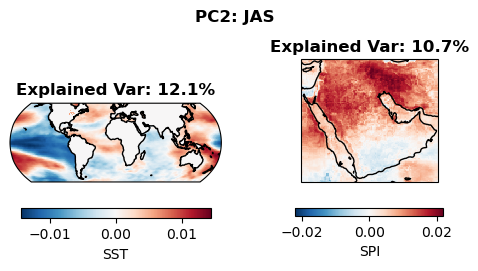

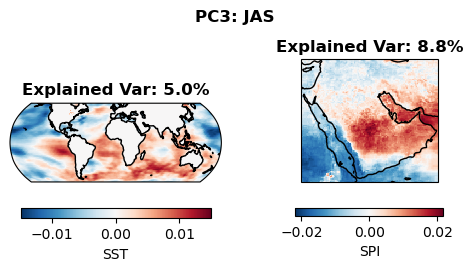

In [94]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='JAS')

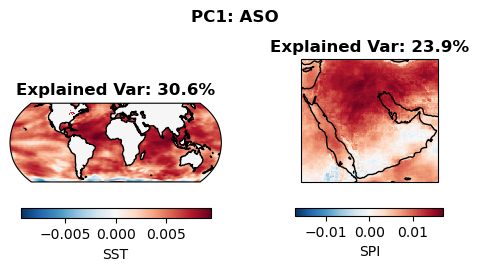

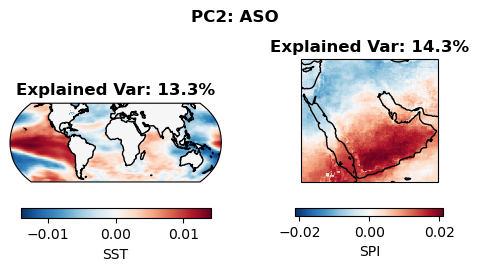

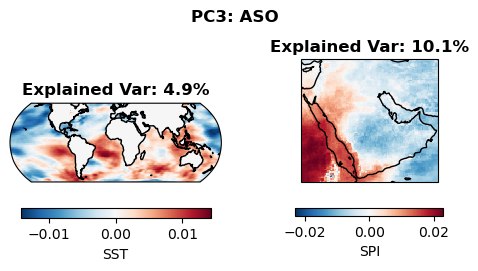

In [95]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='ASO')

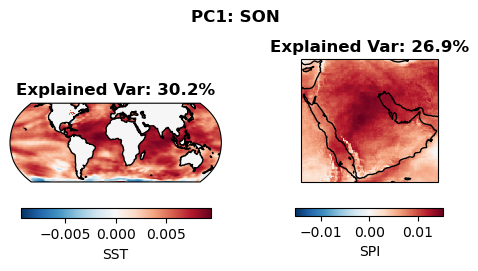

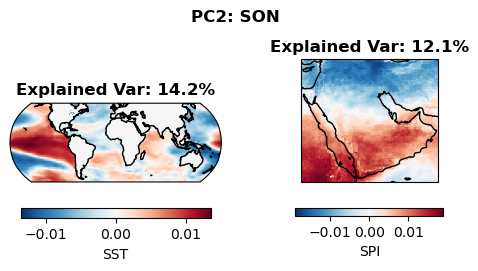

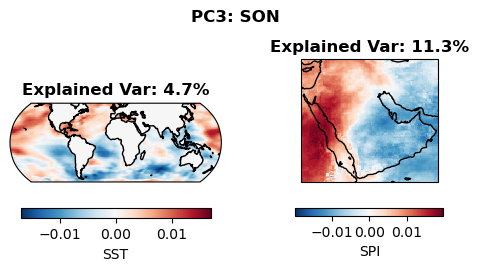

In [96]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='SON')

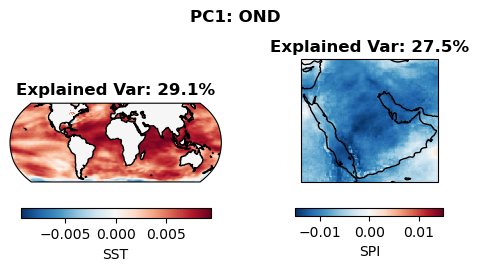

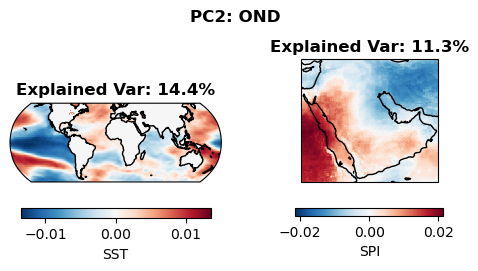

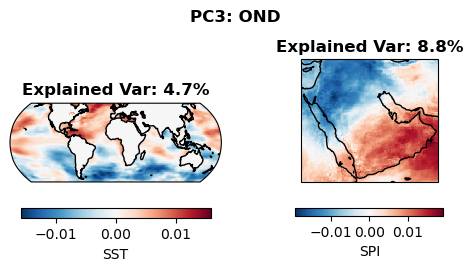

In [99]:
pca_analysis(spi.spi,sst.sst3m, 3, 3, month='OND')

## CCA

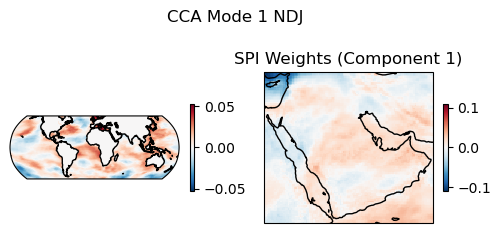

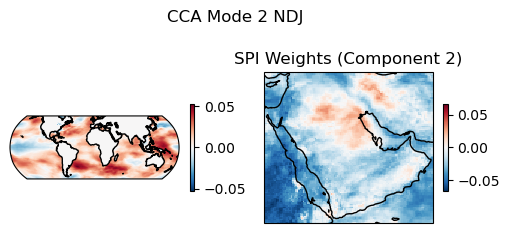

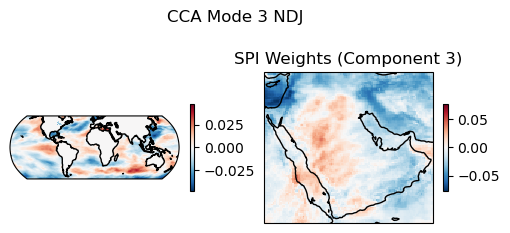

In [108]:
cca_analysis(spi, sst, 3, month='NDJ')

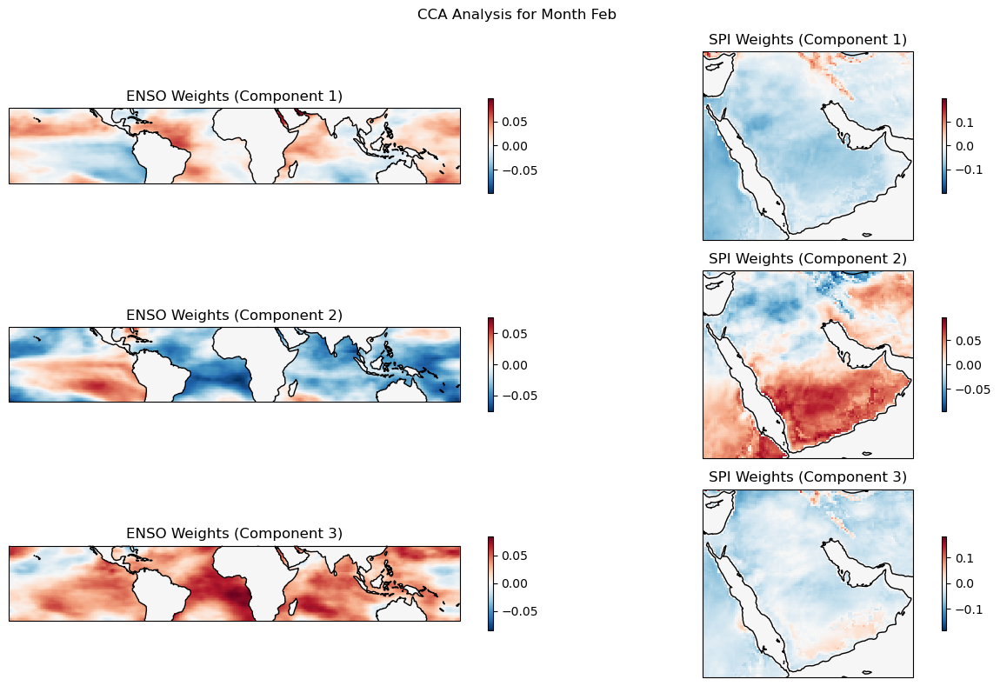

In [115]:
cca_analysis(spi, sst, 3, month='Feb')

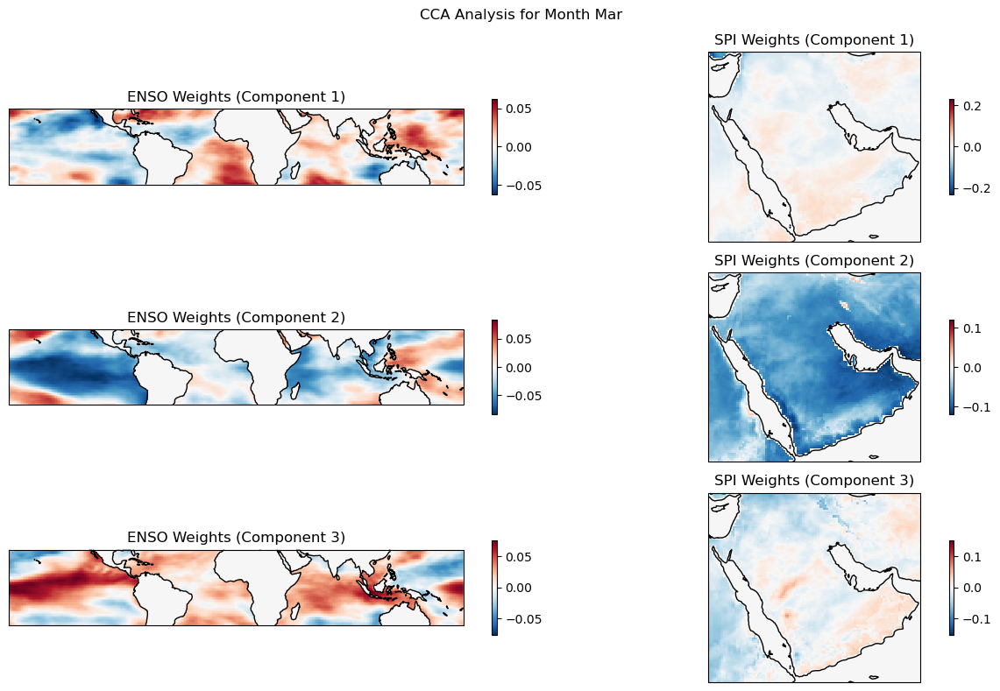

In [116]:
cca_analysis(spi, sst, 3, month='Mar')

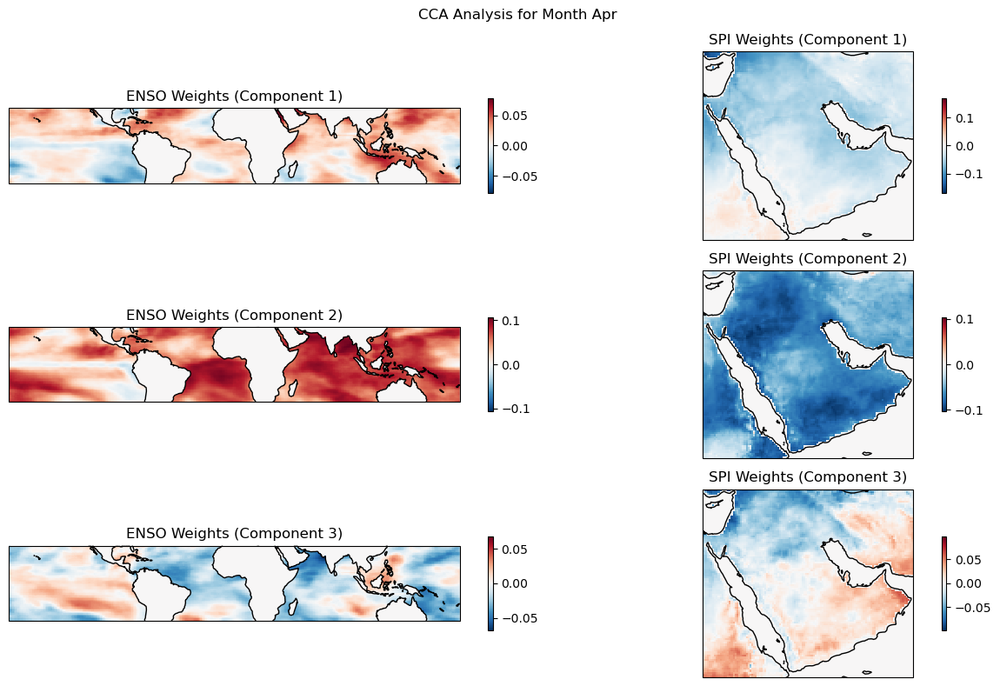

In [117]:
cca_analysis(spi, sst, 3, month='Apr')

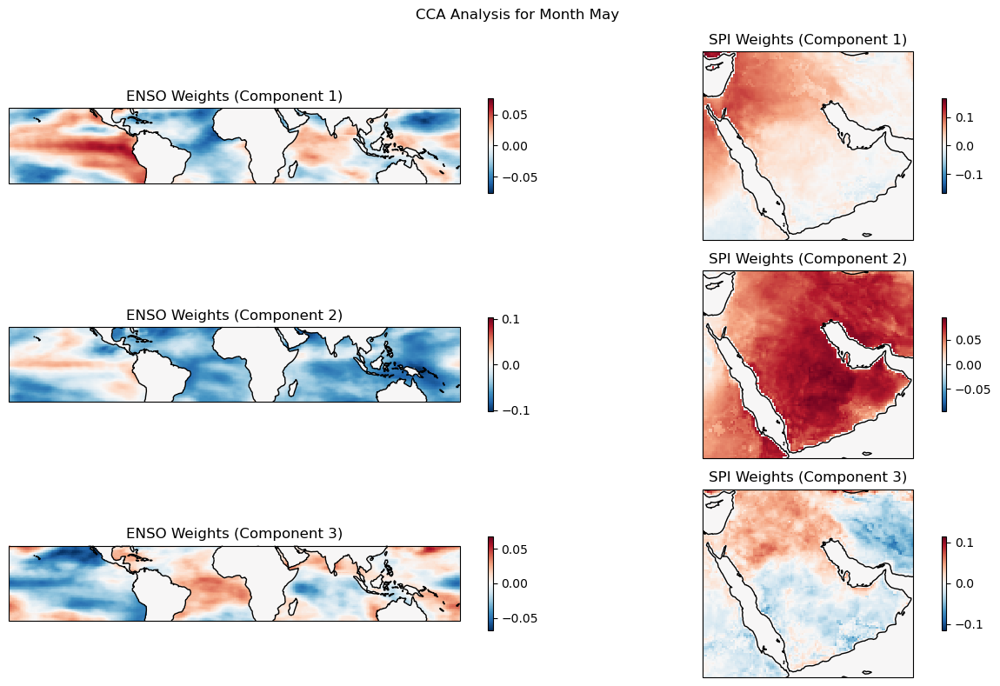

In [118]:
cca_analysis(spi, sst, 3, month='May')

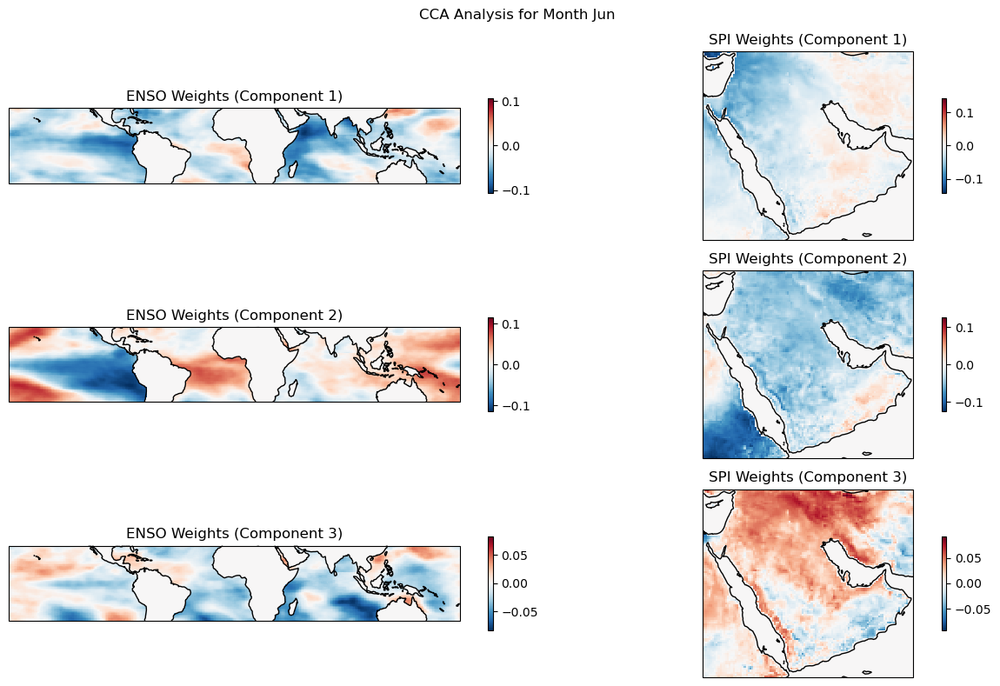

In [119]:
cca_analysis(spi, sst, 3, month='Jun')

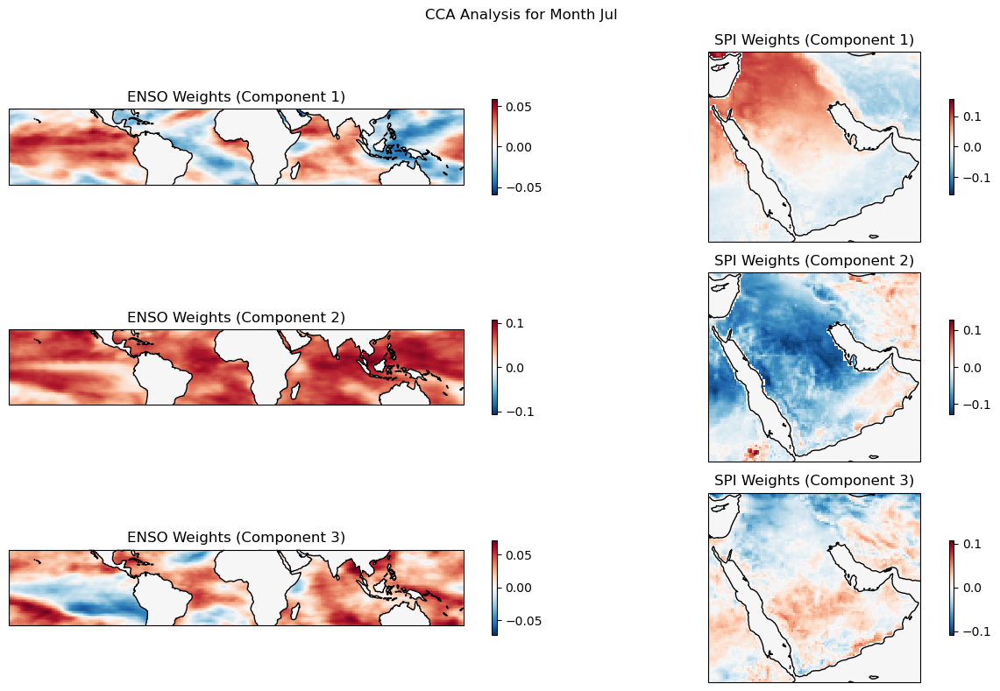

In [120]:
cca_analysis(spi, sst, 3, month='Jul')

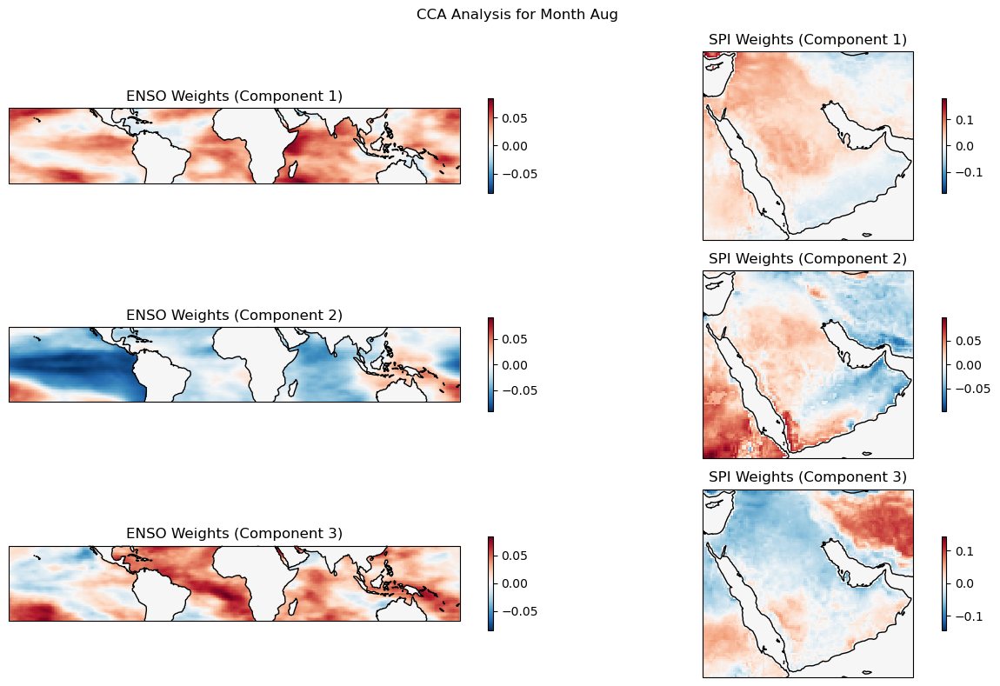

In [121]:
cca_analysis(spi, sst, 3, month='Aug')

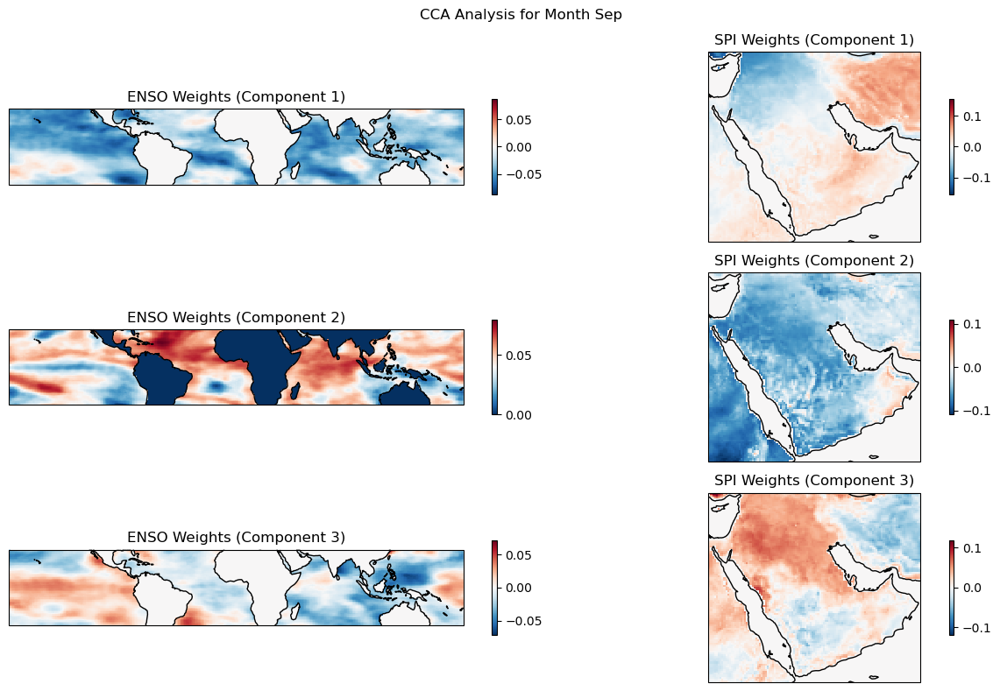

In [122]:
cca_analysis(spi, sst, 3, month='Sep')

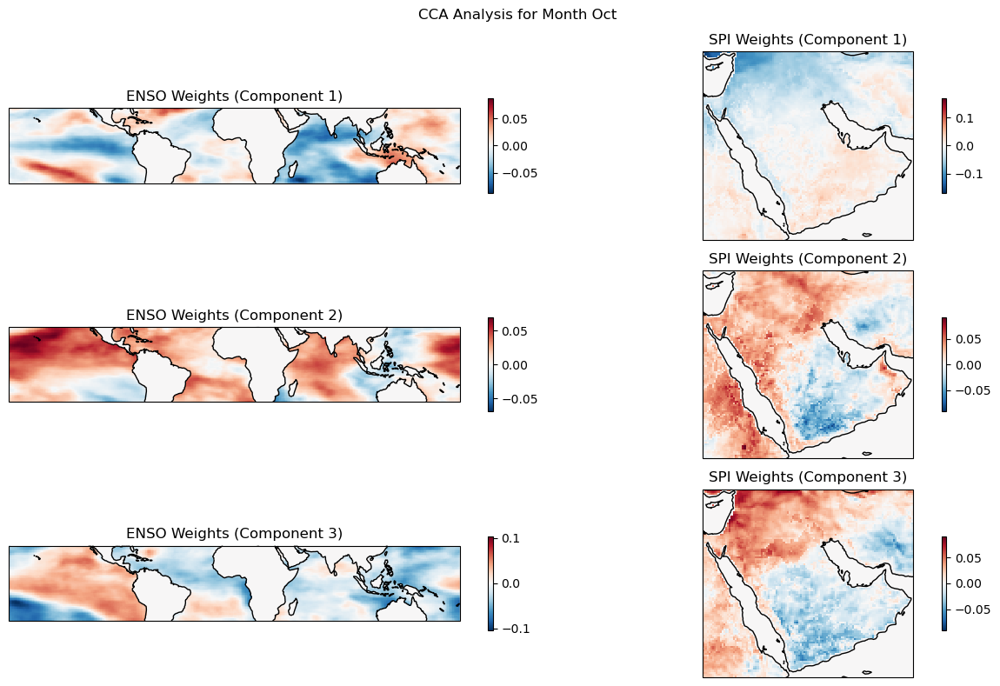

In [123]:
cca_analysis(spi, sst, 3, month='Oct')

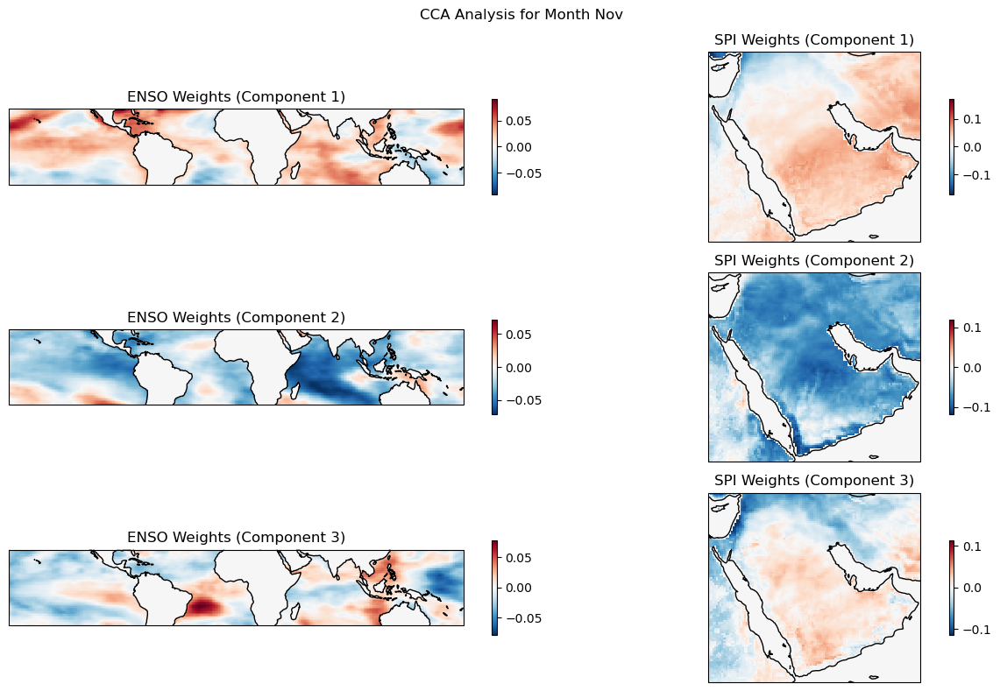

In [124]:
cca_analysis(spi, sst, 3, month='Nov')

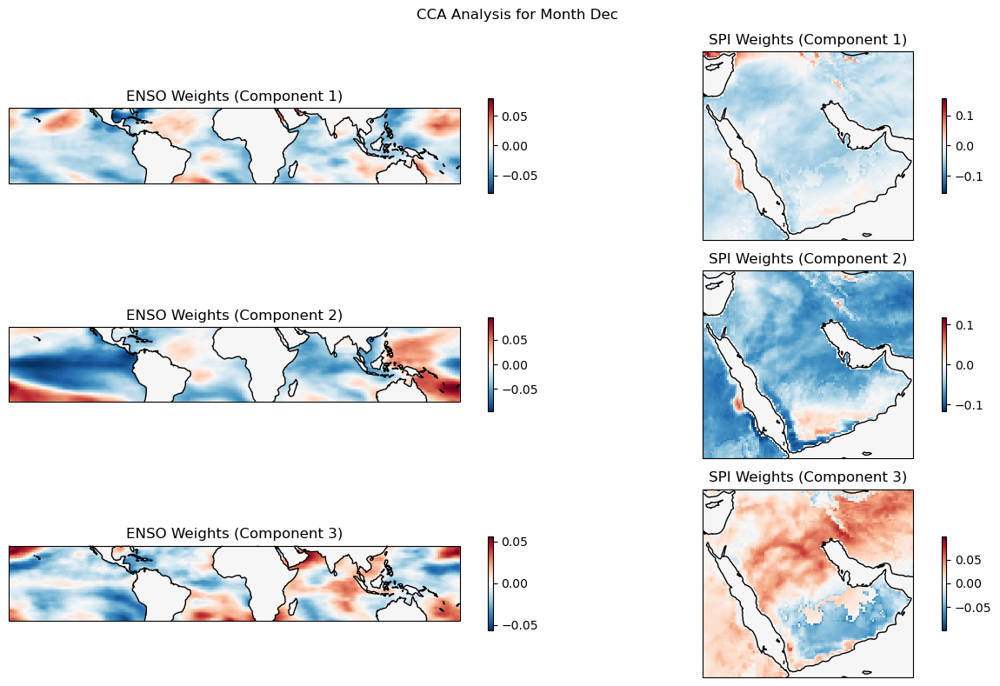

In [125]:
cca_analysis(spi, sst, 3, month='Dec')

## Denoised CCA

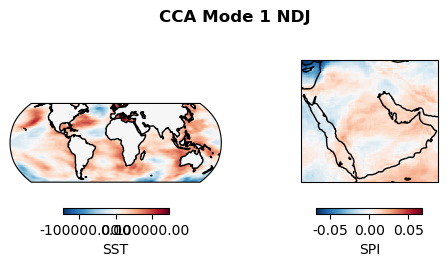

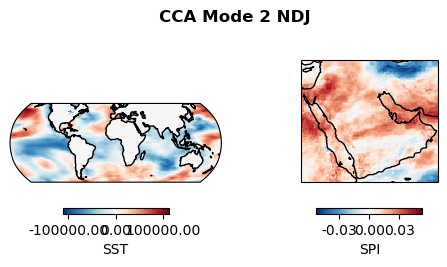

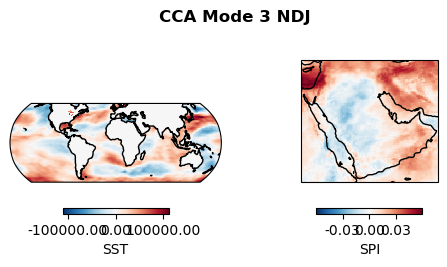

In [113]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=0.9, n_pcs_spi=0.9, month='NDJ')

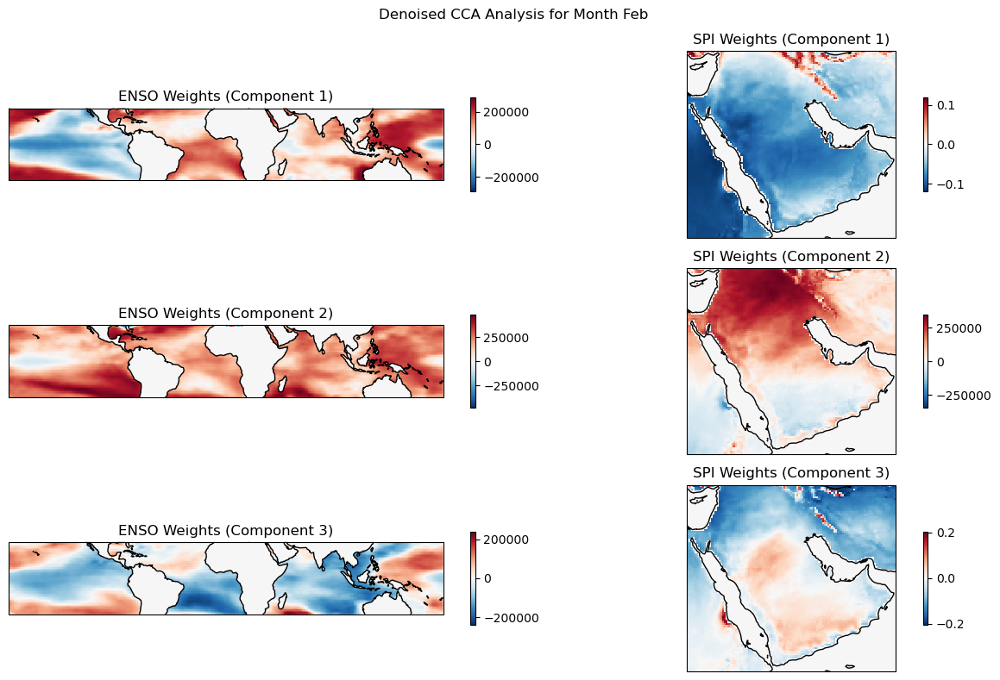

In [127]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Feb')

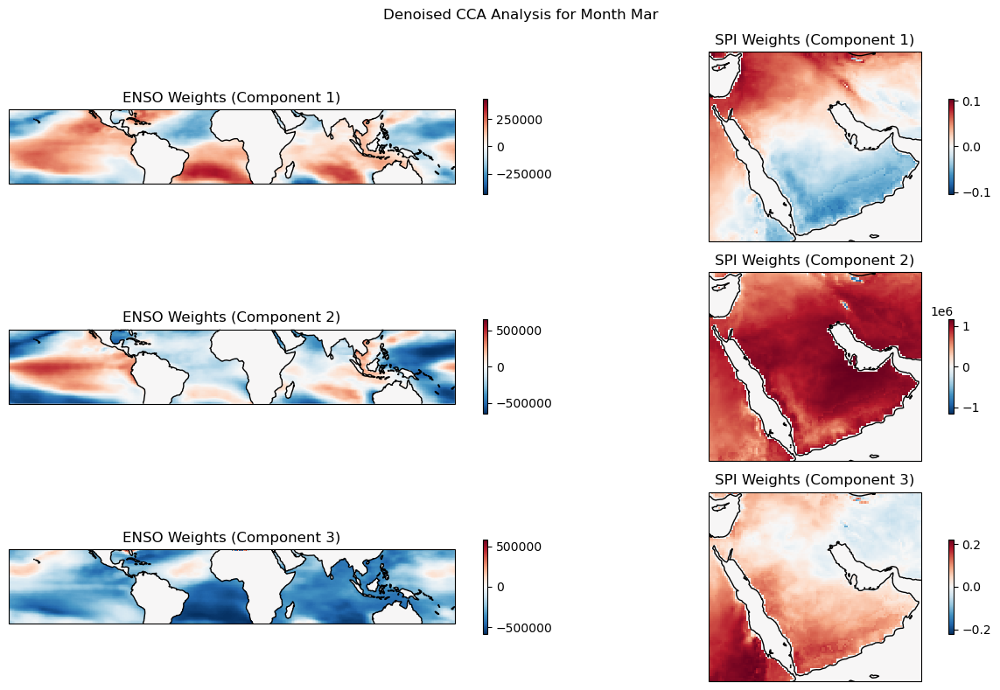

In [128]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Mar')

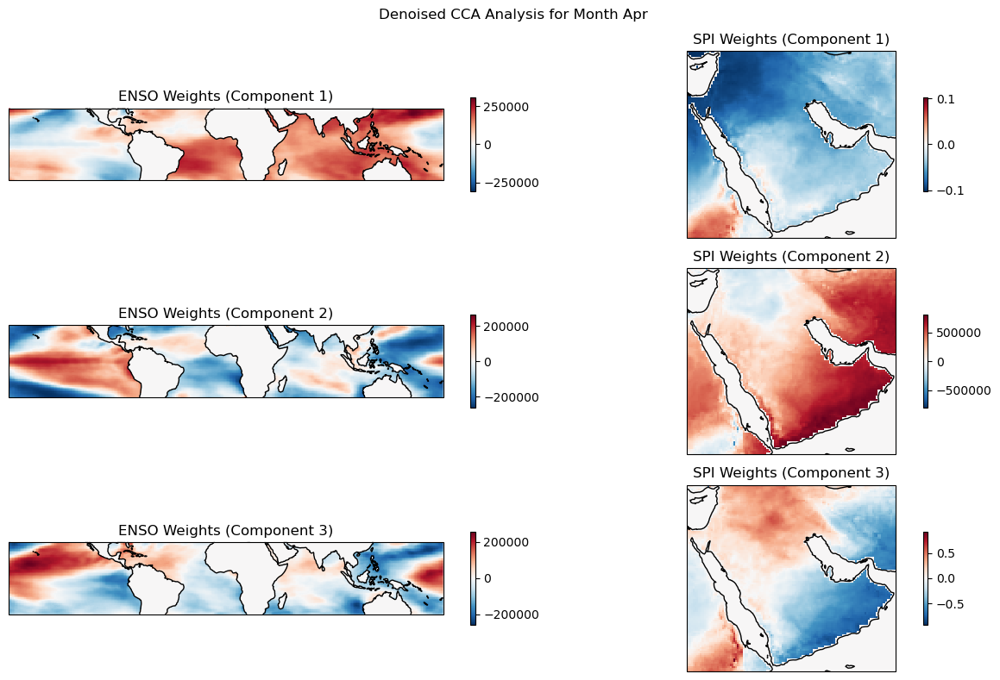

In [129]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Apr')

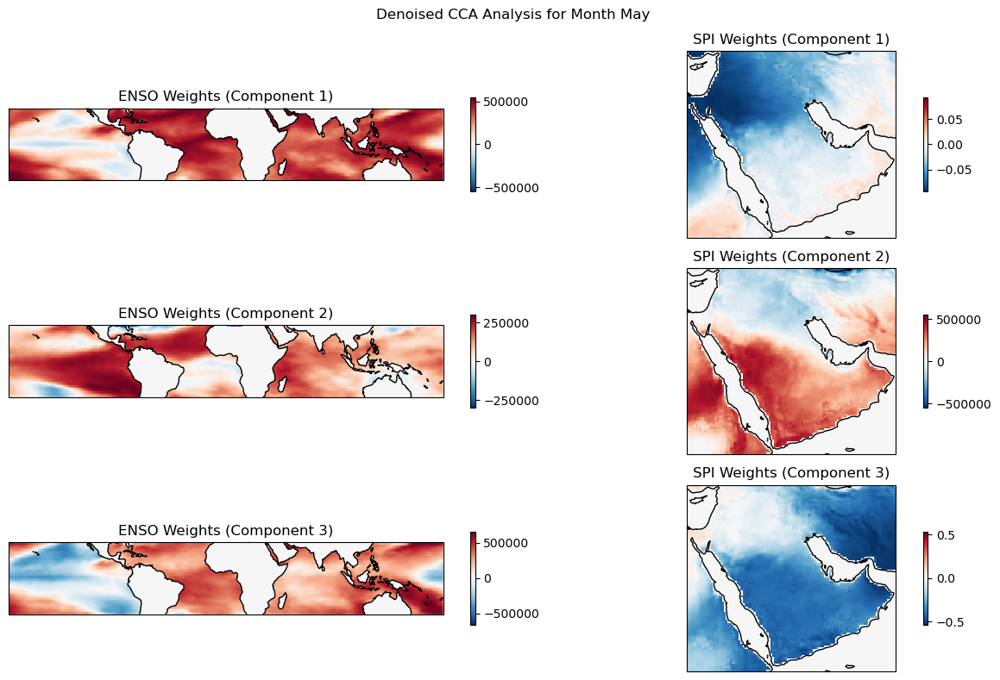

In [130]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='May')

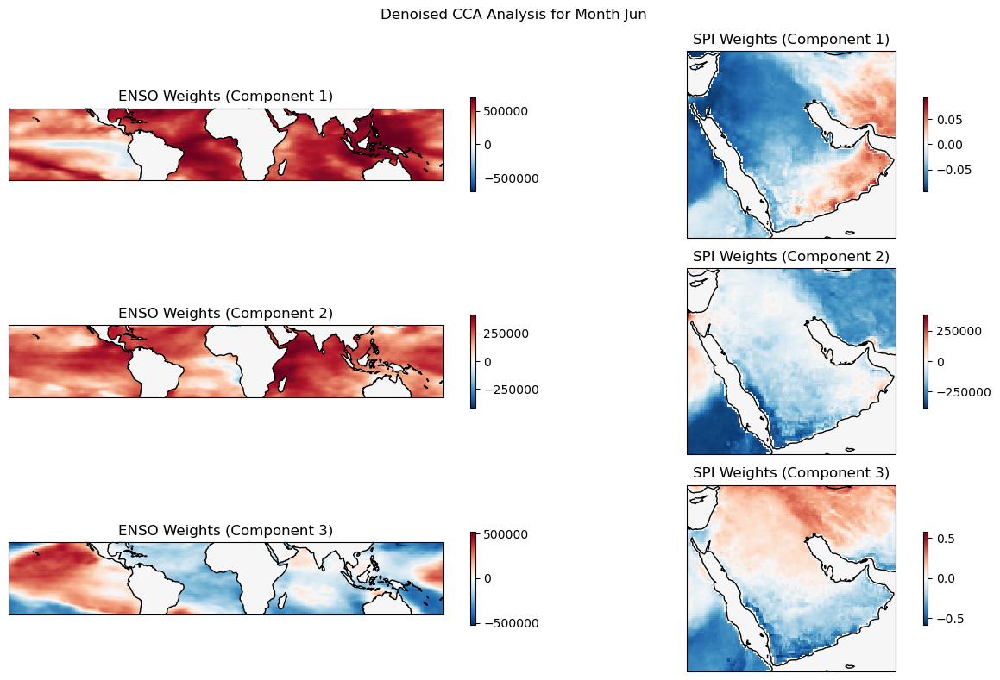

In [131]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Jun')

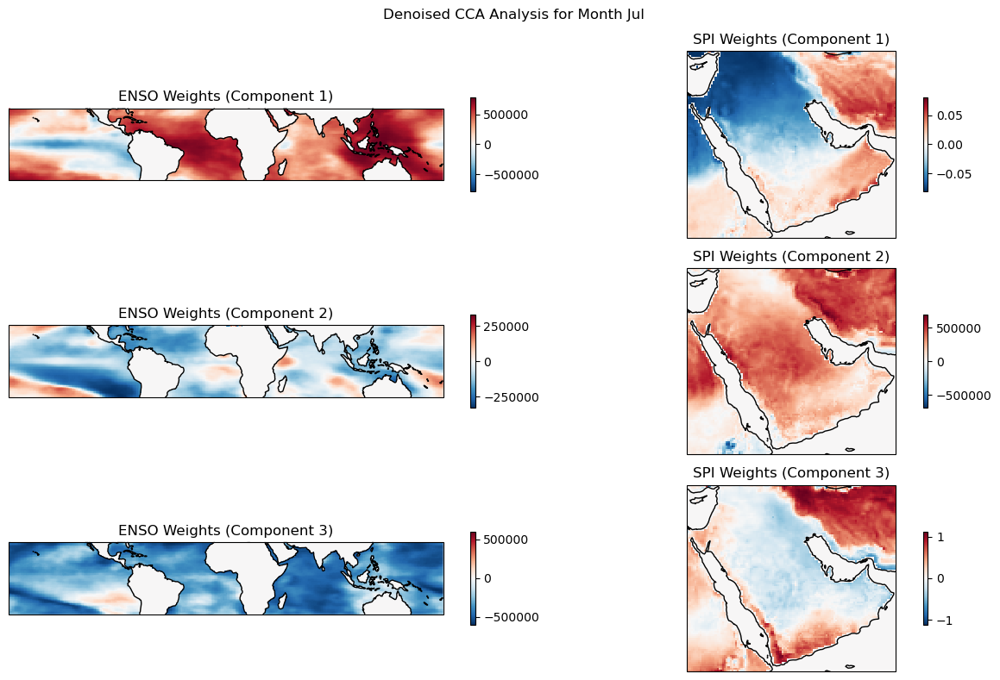

In [132]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Jul')

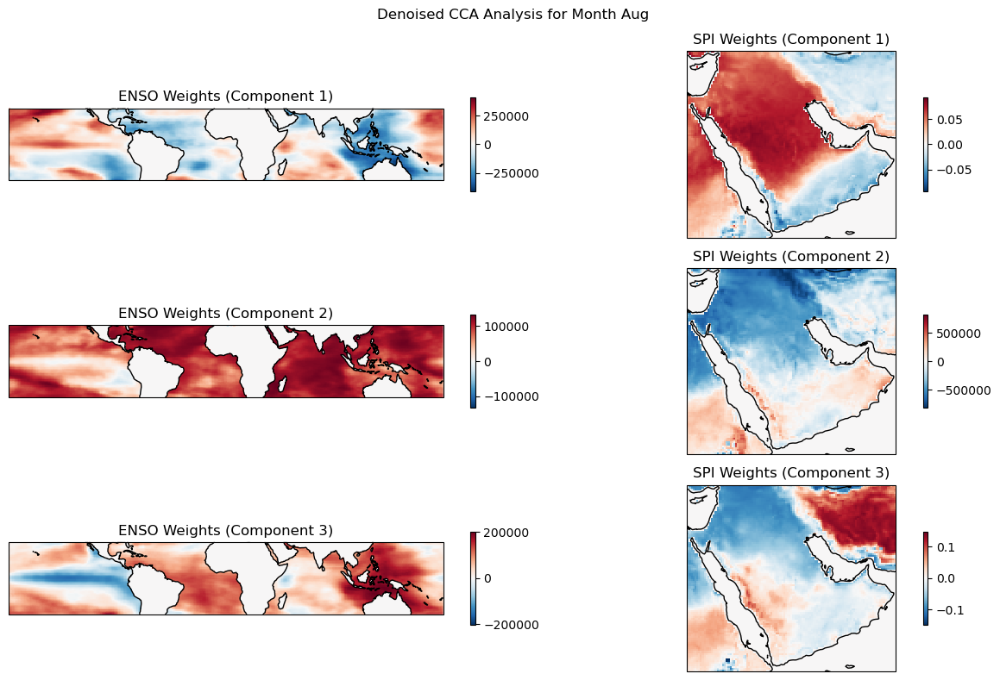

In [133]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Aug')

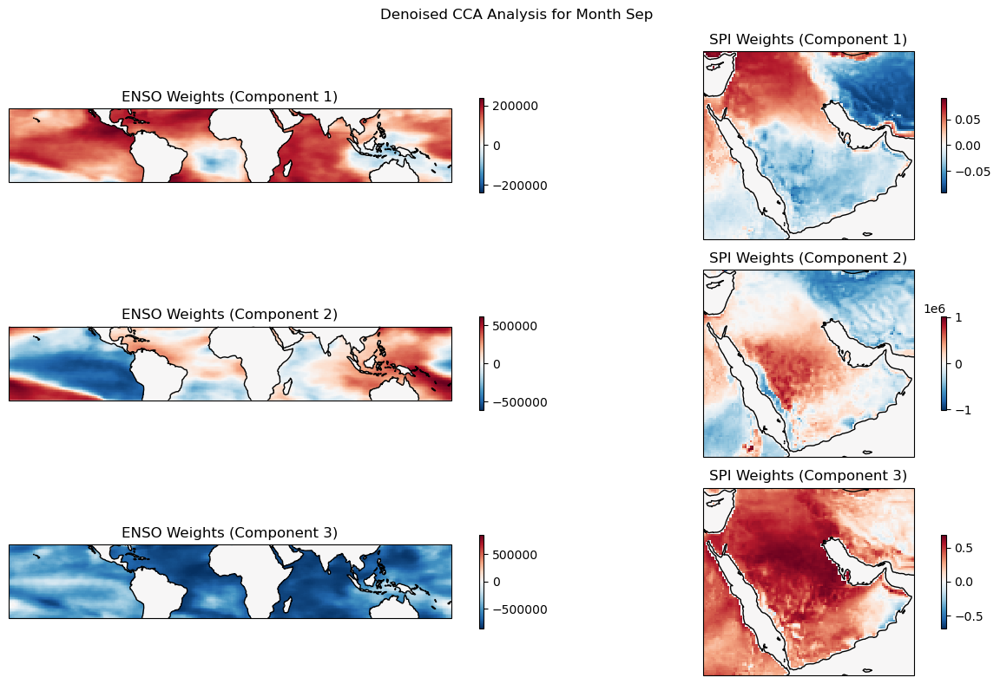

In [134]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Sep')

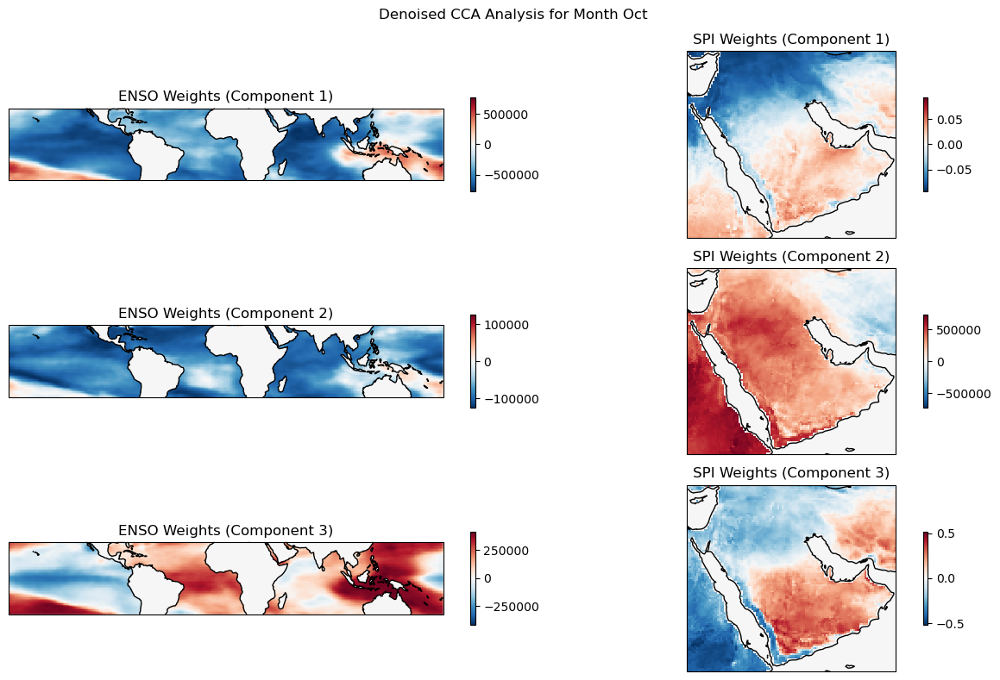

In [135]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Oct')

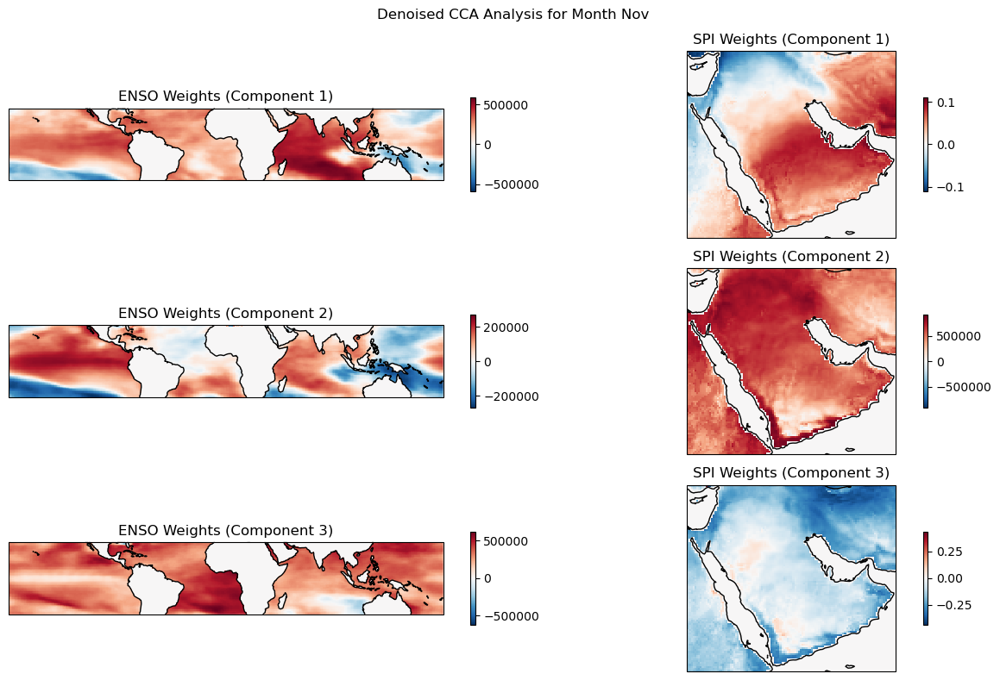

In [136]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Nov')

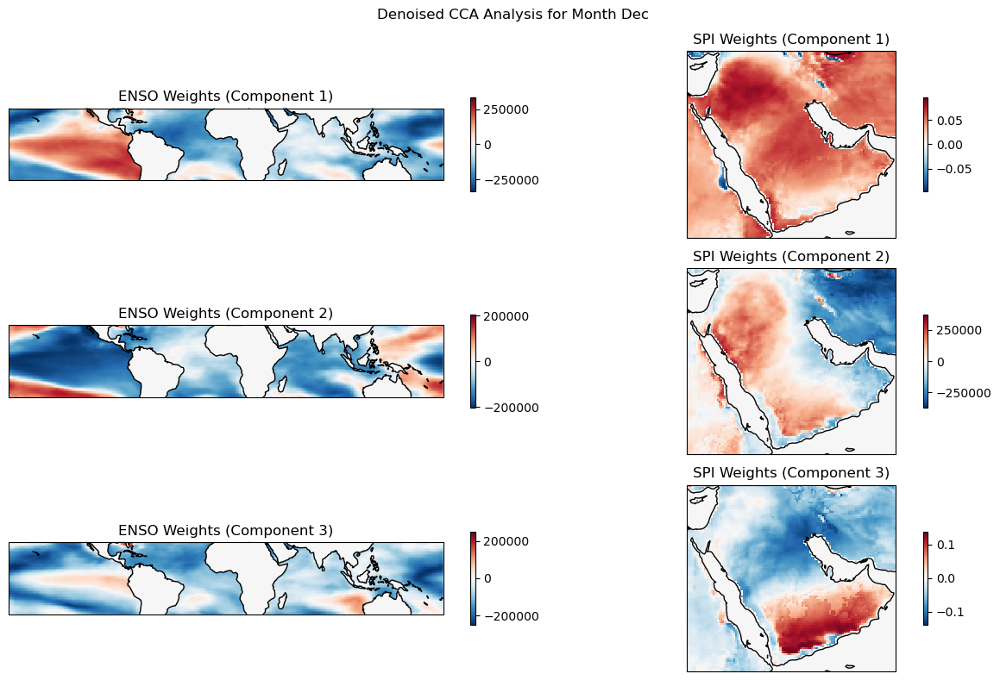

In [137]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Dec')

# PLS forecast

In [5]:
sst = sst.sel(lat=slice(30, -30))

In [6]:
from sklearn.model_selection import GridSearchCV
from sklearn.cross_decomposition import CCA
from sklearn.metrics import r2_score, make_scorer
from sklearn.model_selection import train_test_split

def preprocess(x, y, n_bootstraps=10):

    #convert tine to datetime if not already
    if not isinstance(x['time'].values[0], dt.datetime):
        x['time'] = pd.to_datetime(x['time'].values)
    if not isinstance(y['time'].values[0], dt.datetime):
        y['time'] = pd.to_datetime(y['time'].values)

    x_train_list = []
    y_train_list = []
    x_test_list = []
    y_test_list = []

    for i in range(n_bootstraps):
        np.random.seed(i)  # Change seed per bootstrap to ensure randomness
        years = x['time'].dt.year
        unique_years = np.unique(years)
        shuffled_years = np.random.permutation(unique_years)

        # Calculate the number of years for validation and test sets
        n_years = len(shuffled_years)
        n_test = int(0.3 * n_years)

        # Split the years into training and test sets
        test_years = shuffled_years[:n_test]
        train_years = shuffled_years[n_test:]

        print(f'Bootstrap {i+1}: Training years: {train_years}, Test years: {test_years}')

        # Select data based on the year split
        x_train = x.where(x['time'].dt.year.isin(train_years), drop=True).sortby('time')
        y_train = y.where(y['time'].dt.year.isin(train_years), drop=True).sortby('time')

        x_test = x.where(x['time'].dt.year.isin(test_years), drop=True).sortby('time')
        y_test = y.where(y['time'].dt.year.isin(test_years), drop=True).sortby('time')


        x_train_list.append(x_train)
        y_train_list.append(y_train)
        x_test_list.append(x_test)
        y_test_list.append(y_test)

    return x_train_list, y_train_list, x_test_list, y_test_list


In [7]:
x_train_list, y_train_list, x_test_list, y_test_list = preprocess(sst.sst3m, spi.spi)

Bootstrap 1: Training years: [2024 2000 1963 2005 2007 1952 2001 2018 1950 1979 1998 1974 1957 1996
 1969 1956 1977 1989 2006 1947 1978 2012 1960 1999 1965 1975 1970 1981
 1964 1946 2023 1961 1951 2014 1962 1997 1966 2019 1954 1959 1971 1983
 1992 1985 2011 2004 1958 2016 1982 1967 1955 2021 2013 2010 1993 1990], Test years: [1995 1973 1976 2009 1991 2015 2020 2022 1994 2003 1986 2008 1948 2017
 2002 1980 1949 1968 1953 1972 1988 1984 1987]
Bootstrap 2: Training years: [2002 1965 2007 2022 2013 1972 2023 2011 1990 1988 2006 2024 1967 2016
 1949 1994 2000 1989 1997 1970 1954 1963 1946 2017 1998 1953 2021 2003
 1959 1968 1978 1976 2001 1995 1987 2005 1969 1950 2014 1960 1975 1974
 1957 1964 1966 1996 1971 1952 1947 1962 2010 1951 1955 2018 1958 1983], Test years: [2009 1973 1977 2015 1992 1993 1999 2020 1985 2019 1980 2008 1982 1986
 2004 1956 1984 1948 1981 1979 1991 1961 2012]
Bootstrap 3: Training years: [2016 1973 1956 1991 2005 1964 2022 1946 1957 1978 2017 2008 1955 2021
 1963 2024

In [8]:
def make_forecast(x_train_list, y_train_list, x_test_list, y_test_list, n_components_max=10,n_folds=3,
                  pred_time_step="same"):
    r2_list_outer = []
    corr_list_outer = []
    for month in range(1,13):
        print(f'#### Running forecast for month {month} ##### ')
        r2_list_inner = []
        corr_list_inner = []
        n_bootstraps = len(x_train_list)
        for i in range(10):
            print(f' ... Running forecast for bootstrap {i+1}... ')
            x_train = x_train_list[i]
            y_train = y_train_list[i]
            x_test = x_test_list[i]
            y_test = y_test_list[i]


            x_train = x_train.sel(time=x_train['time.month'] == month)
            y_train = y_train.sel(time=y_train['time.month'] == month)
            x_test = x_test.sel(time=x_test['time.month'] == month)
            y_test = y_test.sel(time=y_test['time.month'] == month)

            if pred_time_step == "lag":
                y_train = y_train.isel(time=slice(1, None))
                x_train = x_train.isel(time=slice(None, -1))
                y_test = y_test.isel(time=slice(1, None))
                x_test = x_test.isel(time=slice(None, -1))
            elif pred_time_step == "same":
                pass
            else:
                raise ValueError("Invalid value for pred_time_step. Choose 'lag' or 'same'.")
            

            # Flatten spatial dimensions into a single dimension
            x_train_2d = x_train.fillna(0).values.reshape(x_train.shape[0], -1)
            y_train_2d = y_train.fillna(0).values.reshape(y_train.shape[0], -1)
            x_test_2d = x_test.fillna(0).values.reshape(x_test.shape[0], -1)

            # Train the PLS regression model
            regressor = PLSRegression(n_components=5)

            # #gridsearch
            # param_grid = {'n_components': np.arange(1, n_components_max+1,1)}
            # grid = GridSearchCV(regressor, param_grid, cv=n_folds, scoring='r2', verbose=1)
            # grid.fit(x_train_2d, y_train_2d)
            # regressor = grid.best_estimator_
            regressor.fit(x_train_2d, y_train_2d)

            # Predict and reshape back to original dimensions
            forecast = regressor.predict(x_test_2d)
            forecast = forecast.reshape(y_test.shape)

            forecast_xr = xr.DataArray(forecast, coords={'time': y_test.time, 'lat': y_test.lat, 'lon': y_test.lon}, dims=['time', 'lat', 'lon'])
            corr = xr.corr(forecast_xr, y_test, dim='time')

            # Flatten the time axis for vectorized computation
            forecast_flat = forecast.reshape(forecast.shape[0], -1)
            y_test_flat = y_test.values.reshape(y_test.shape[0], -1)

            # Compute R² scores for each grid point (vectorized)
            ss_total = np.sum((y_test_flat - np.mean(y_test_flat, axis=0)) ** 2, axis=0)
            ss_residual = np.sum((y_test_flat - forecast_flat) ** 2, axis=0)


            valid_mask = ss_total > 0  # Mask for non-zero variance
            r2_scores_flat = np.zeros_like(ss_total)
            r2_scores_flat[valid_mask] = 1 - (ss_residual[valid_mask] / ss_total[valid_mask])

            # Reshape back to spatial dimensions (lat, lon)
            r2_scores = r2_scores_flat.reshape(forecast.shape[1:])

            r2_xr = xr.DataArray(r2_scores, coords={'lat': y_test.lat, 'lon': y_test.lon}, dims=['lat', 'lon'])
            r2_list_inner.append(r2_xr)

            corr_list_inner.append(corr)

        r2_bootstraps = xr.concat(r2_list_inner, dim='bootstrap')
        corr_bootstraps = xr.concat(corr_list_inner, dim='bootstrap')
        r2_list_outer.append(r2_bootstraps)
        corr_list_outer.append(corr_bootstraps)

    return xr.concat(r2_list_outer, dim='month'), xr.concat(corr_list_outer, dim='month')


In [9]:
mask = xr.open_dataarray('data/spi_mask_3m.nc')
#turn into mask with 0 if na and 1 if not
mask = xr.where(np.isnan(mask), np.nan, 1)
#turn mask into monthly mask
mask = mask.groupby('T.month').mean()
#change coords from X Y ro lon lat
mask = mask.rename({'X':'lon', 'Y':'lat'})

In [24]:
def plot_skill_scores(r2_xr, corr_xr, cmap='RdBu_r', masks=mask):
    for month in range(1, 13):  
        # Select data for the current month
        r2_month = r2_xr.sel(month=month - 1)
        corr_month = corr_xr.sel(month=month - 1)
        mask_month = masks.sel(month=month)

        # Calculate statistics for R²
        r2 = r2_month.mean(dim='bootstrap').where(mask_month == 1)
        r2_mean = r2.mean().item()
        r2_max = r2.max().item()
        r2_min = r2.min().item()

        # Calculate statistics for correlation
        corr = corr_month.mean(dim='bootstrap').where(mask_month == 1)
        corr_mean = corr.mean().item()
        corr_max = corr.max().item()
        corr_min = corr.min().item()

        # Set up the figure with two subplots
        fig, axes = plt.subplots(
            nrows=1, ncols=1, figsize=(10, 4),
            subplot_kw={'projection': ccrs.PlateCarree()}
        )
        month_strings = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']

        # # Plot the R² scores
        # r2.plot(
        #     ax=axes[0],
        #     cmap=cmap,
        #     vmin=-0.2,
        #     vmax=0.2,
        #     add_colorbar=True,
        #     transform=ccrs.PlateCarree(),
        #     cbar_kwargs={
        #         'shrink': 0.4,
        #         'label': 'R² Score',
        #         'orientation': 'horizontal',
        #         'format': '%.2f',
        #     },
        # )
        # axes[0].coastlines()
        # axes[0].set_title(
        #     f'R² Score - {month_strings[month - 1]}\n'
        #     f'Mean: {"<-10" if r2_mean < -10 else f"{r2_mean:.2f}"}, '
        #     f'Max: {"<-10" if r2_max < -10 else f"{r2_max:.2f}"}, '
        #     f'Min: {"<-10" if r2_min < -10 else f"{r2_min:.2f}"},',
        #     fontweight='bold'
        # )

        # Plot the correlation scores
        corr.plot(
            ax=axes,
            cmap=cmap,
            vmin=-0.3,
            vmax=0.8,
            add_colorbar=True,
            transform=ccrs.PlateCarree(),
            cbar_kwargs={
                'shrink': 0.3,
                'label': 'Correlation',
                'orientation': 'horizontal',
                'format': '%.2f',
            },
        )
        axes.coastlines()
        axes.set_title(
            f'Correlation - {month_strings[month - 1]}\nMean: {corr_mean:.2f}, Max: {corr_max:.2f}, Min: {corr_min:.2f}', 
            fontweight='bold'
        )

        # Adjust layout and show the figure
        plt.tight_layout()
        plt.show()


## contemporary

In [11]:
r2_xr, corr_xr = make_forecast(x_train_list, y_train_list, x_test_list, y_test_list, n_components_max=10)

#### Running forecast for month 1 ##### 
 ... Running forecast for bootstrap 1... 
 ... Running forecast for bootstrap 2... 
 ... Running forecast for bootstrap 3... 
 ... Running forecast for bootstrap 4... 
 ... Running forecast for bootstrap 5... 
 ... Running forecast for bootstrap 6... 
 ... Running forecast for bootstrap 7... 
 ... Running forecast for bootstrap 8... 
 ... Running forecast for bootstrap 9... 
 ... Running forecast for bootstrap 10... 
#### Running forecast for month 2 ##### 
 ... Running forecast for bootstrap 1... 
 ... Running forecast for bootstrap 2... 
 ... Running forecast for bootstrap 3... 
 ... Running forecast for bootstrap 4... 
 ... Running forecast for bootstrap 5... 
 ... Running forecast for bootstrap 6... 
 ... Running forecast for bootstrap 7... 
 ... Running forecast for bootstrap 8... 
 ... Running forecast for bootstrap 9... 
 ... Running forecast for bootstrap 10... 
#### Running forecast for month 3 ##### 
 ... Running forecast for bootstrap

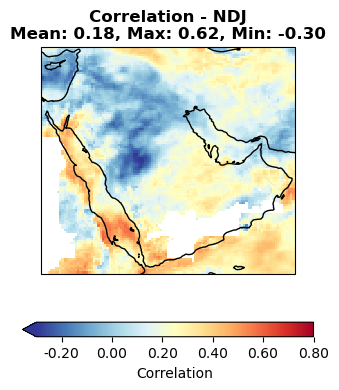

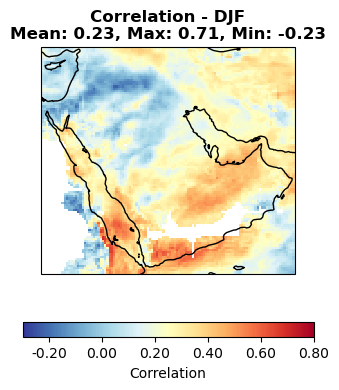

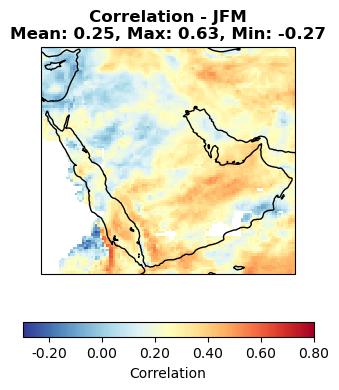

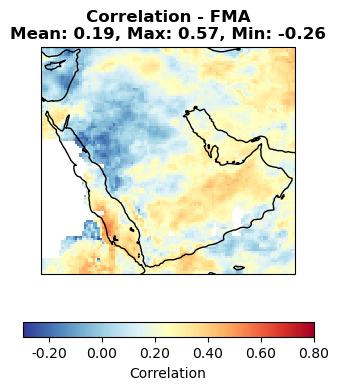

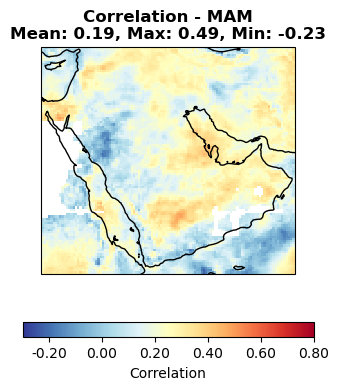

...

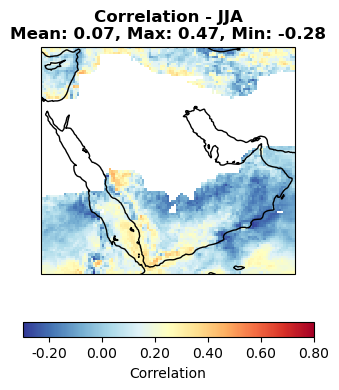

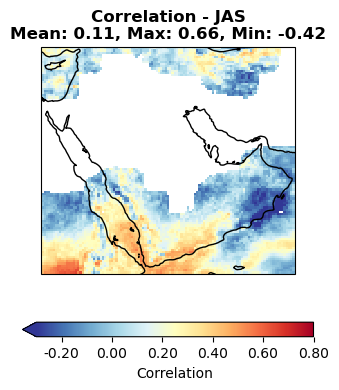

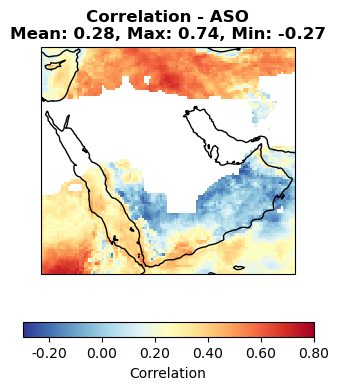

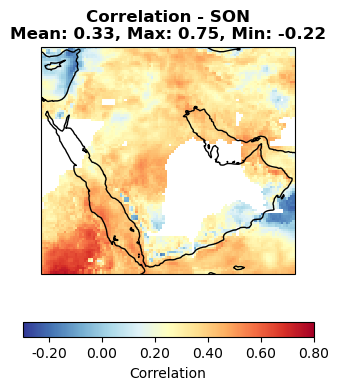

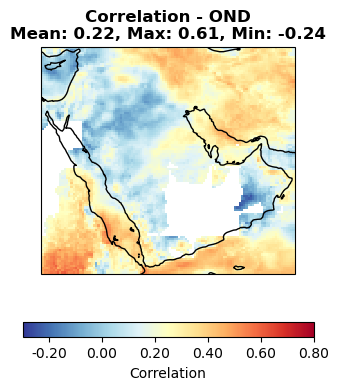

In [25]:
plot_skill_scores(r2_xr, corr_xr,cmap="RdYlBu_r")

## lagged

In [140]:
r2_xr_lag, corr_xr_lag = make_forecast(x_train_list, y_train_list, x_test_list, y_test_list, n_components_max=10,
                                        pred_time_step='lag')

#### Running forecast for month 1 ##### 
 ... Running forecast for bootstrap 1... 
 ... Running forecast for bootstrap 2... 
 ... Running forecast for bootstrap 3... 
 ... Running forecast for bootstrap 4... 
 ... Running forecast for bootstrap 5... 
 ... Running forecast for bootstrap 6... 
 ... Running forecast for bootstrap 7... 
 ... Running forecast for bootstrap 8... 
 ... Running forecast for bootstrap 9... 
 ... Running forecast for bootstrap 10... 
#### Running forecast for month 2 ##### 
 ... Running forecast for bootstrap 1... 
 ... Running forecast for bootstrap 2... 
 ... Running forecast for bootstrap 3... 
 ... Running forecast for bootstrap 4... 
 ... Running forecast for bootstrap 5... 
 ... Running forecast for bootstrap 6... 
 ... Running forecast for bootstrap 7... 
 ... Running forecast for bootstrap 8... 
 ... Running forecast for bootstrap 9... 
 ... Running forecast for bootstrap 10... 
#### Running forecast for month 3 ##### 
 ... Running forecast for bootstrap

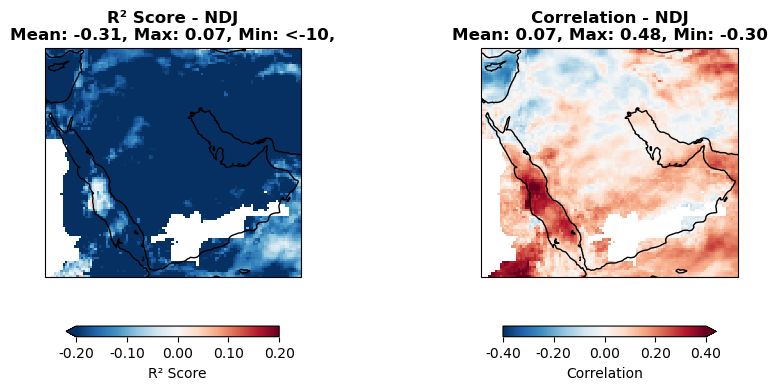

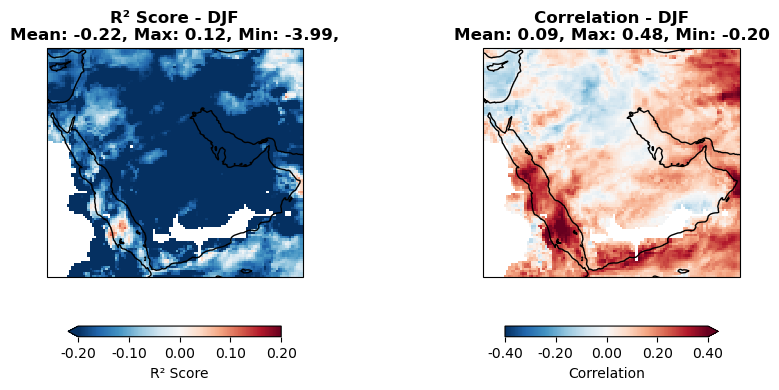

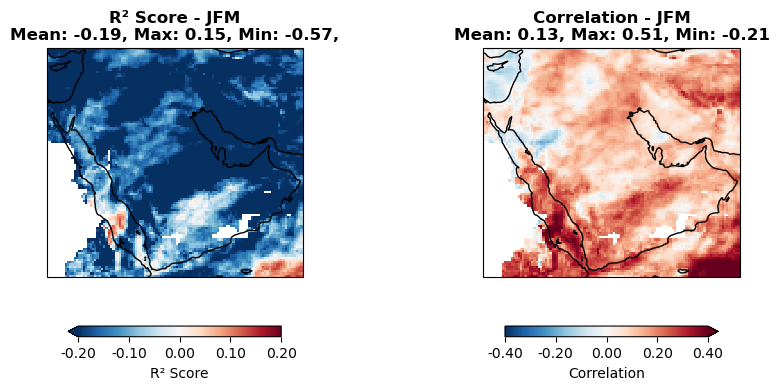

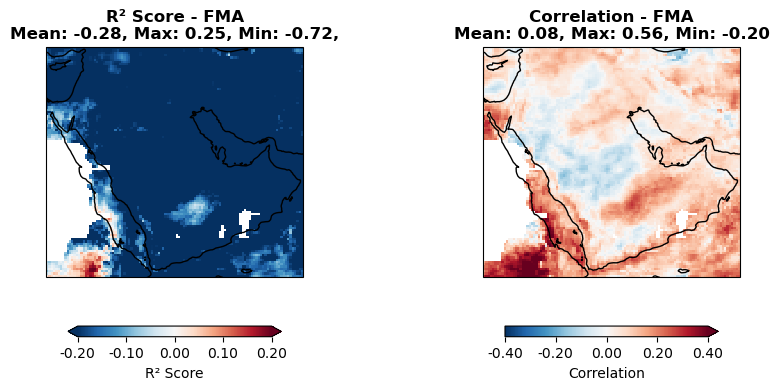

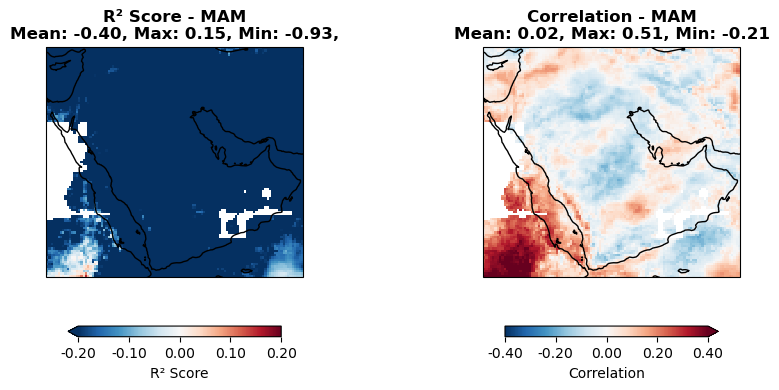

...

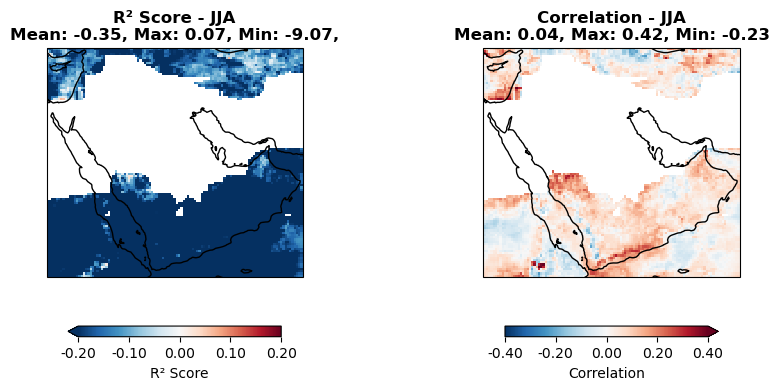

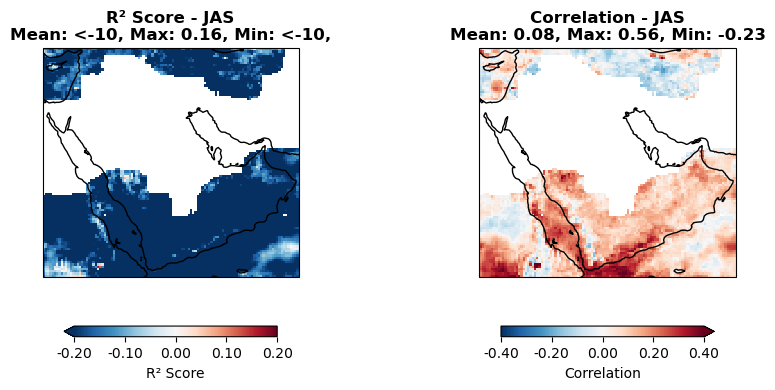

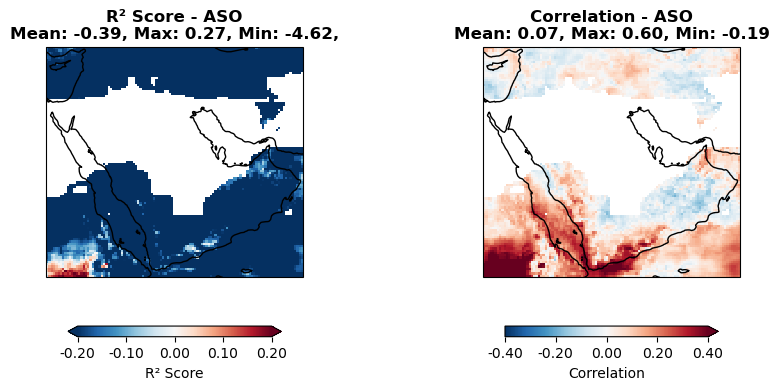

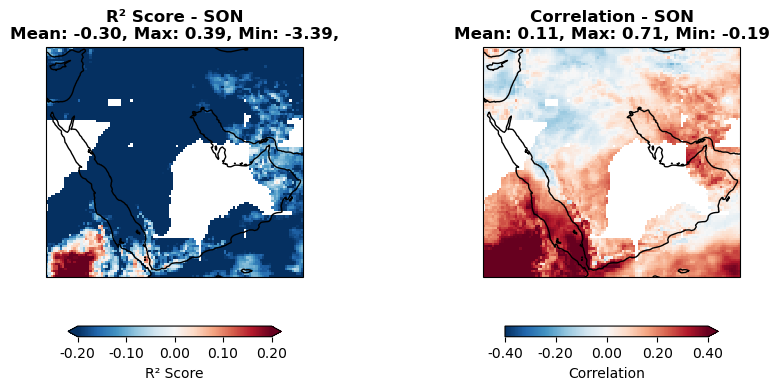

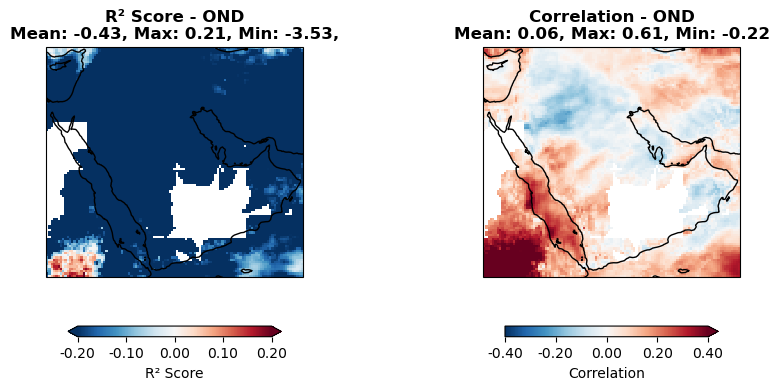

In [141]:
plot_skill_scores(r2_xr_lag, corr_xr_lag)

# Reproduce pycpt

In [4]:
import pycpt
import packaging
min_version = '2.5.0'
assert packaging.version.parse(pycpt.__version__) >= packaging.version.parse(min_version), f'This notebook requires version {min_version} or higher of the pycpt library, but you have version {pycpt.__version__}. Please close the notebook, update your environment, and load the notebook again. See https://iri-pycpt.github.io/installation/'

import cptdl as dl 
from cptextras import get_colors_bars
import datetime as dt
import numpy as np
from pathlib import Path
import xarray as xr
import cptcore as cc

In [163]:
x, y = cc.load_southasia_nmme()
x = x.isel(T=slice(None,-1))
hindcasts, forecasts, skills, patterns_x, patterns_y = cc.canonical_correlation_analysis(x, y,cpt_kwargs={'interactive':True},x_eof_modes=(4,5), y_eof_modes=(4,5))

  
  
             C L I M A T E   P R E D I C T A B I L I T Y   T O O L
                                 Version 17.08
  
                   Evaluating seasonal climate predictability
                         Designed for MOS applications
  
  
  Copyright 2002-2023 International Research Institute for Climate and Society
  
  
 III RRRR  III                                                                 
  I  R   R  I                                                                  
  I  R   R  I                                                                  
  I  RRRR   I                                                                  
  I  R   R  I   I N T E R N A T I O N A L   R E S E A R C H   I N S T I T U T E
 III R   R III  F O R         C L I M A T E         A N D         S O C I E T Y
  
  
 FILE
       141.  New
       142.  Open
       144.  Save As
       145.  Save as Parameter File (turn on)
       131.  Output-file format
       132.  Output-data precision
       1

In [164]:
#impleement class MCA that computes SVD of cross covariance matri xof inputs X, Y

class MCA:
    def __init__(self, X, Y):
        self.X = X
        self.Y = Y
        self.n_components = min(X.shape[1], Y.shape[1])
        self.solve()
        
    def fit(self):
        self.U, self.S, self.V = np.linalg.svd(self.X.T @ self.Y)
        self.U = self.U[:, :self.n_components]
        self.V = self.V[:self.n_components, :]
        self.S = self.S[:self.n_components]
        self.x_cca = self.X @ self.U
        self.y_cca = self.Y @ self.V
        self.x_weights = self.U
        self.y_weights = self.V
        self.skills = self.S**2 / np.sum(self.S**2)
        
#implement class CCA to perform canonical correlation analysis

class MyCCA:
    def __init__(self):
        self.X_weights_ = None
        self.Y_weights_ = None
        self.X_proj_ = None
        self.Y_proj_ = None
        self.covariance_explained_ = None

    def fit(self, X, Y):
        # Center the variables (mean subtraction)
        X = X - X.mean(axis=0)
        Y = Y - Y.mean(axis=0)

        U1,s1,V1t = np.linalg.svd(X,full_matrices=False)
        V1 = V1t.T
        U2,s2,V2t = np.linalg.svd(Y,full_matrices=False)
        V2 = V2t.T

        U1tU2 = U1.T.dot(U2)
        U3,s3,V3t = np.linalg.svd(U1tU2)
        V3 = V3t.T
        
        self.X_weights_ = V1 @ np.linalg.inv(np.diag(s1)) @ U3
        self.Y_weights_ = V2 @ np.linalg.inv(np.diag(s2)) @ V3


        # Project the data onto the canonical variables
        self.X_proj_ = np.dot(X, self.X_weights_)
        self.Y_proj_ = np.dot(Y, self.Y_weights_)

        # Compute the covariance explained by the canonical correlations
        self.covariance_explained_ = s3 / s3.sum()

        return self

pycpt datasets sst and precip or era5 sst + precip

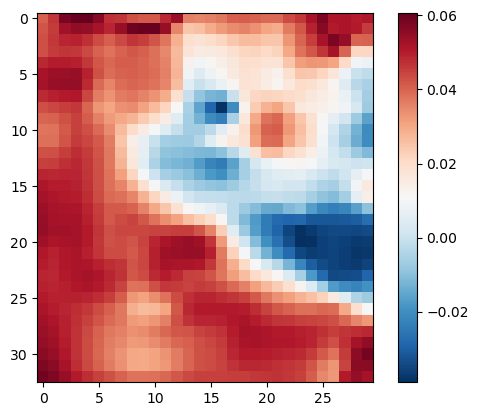

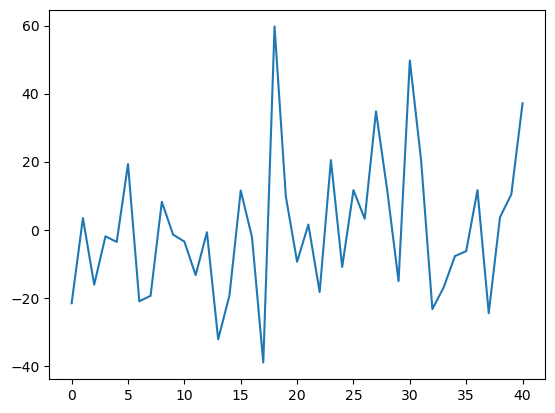

In [168]:
x_2d = x.values.reshape(x.shape[0], -1)
y_2d = y.values.reshape(y.shape[0], -1)

#remove last year from y
y_2d = y_2d[1:]

x_2d_bar = x_2d #  - x_2d.mean(axis=0)
y_2d_bar = y_2d # - y_2d.mean(axis=0)

pca_x = PCA(n_components=4).fit(x_2d_bar)
pca_y = PCA(n_components=4).fit(y_2d_bar)

x_pcs = pca_x.transform(x_2d_bar)
y_pcs = pca_y.transform(y_2d_bar)

#inverse transform
x_denoised = pca_x.inverse_transform(x_pcs)  + x_2d.mean(axis=0)
y_denoised = pca_y.inverse_transform(y_pcs)   + y_2d.mean(axis=0)

x_denoised = (x_denoised) # - x_denoised.mean(axis=0))  / (x_denoised.std(axis=0) + 1e-6)
y_denoised = (y_denoised ) #- y_denoised.mean(axis=0))  / (y_denoised.std(axis=0) + 1e-6)

cca = CCA(n_components=5)

x_cca, y_cca = cca.fit_transform(x_denoised, y_denoised)
x_loadings = cca.x_loadings_
y_loadings = cca.y_loadings_

#plot
plt.imshow(y_loadings[:,0].reshape(x.shape[1], x.shape[2]), cmap='RdBu_r')
plt.colorbar()
plt.show()
plt.plot(x_cca[:,0])

In [176]:
mycca = MCA(x_denoised, y_denoised)

plt.plot(mycca.X_proj_[:,0])

AttributeError: 'MCA' object has no attribute 'X_proj_'

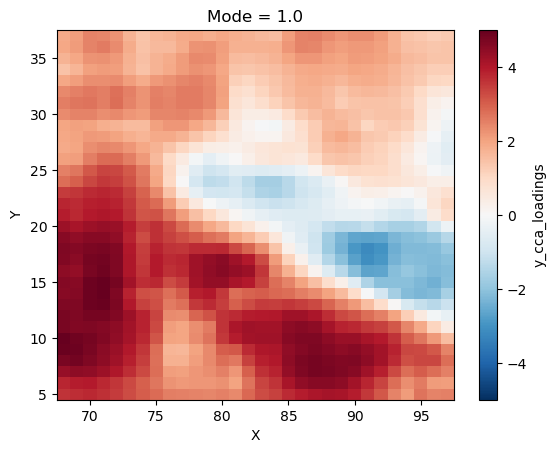

In [166]:
patterns_y.y_cca_loadings.sel(Mode=1).plot()

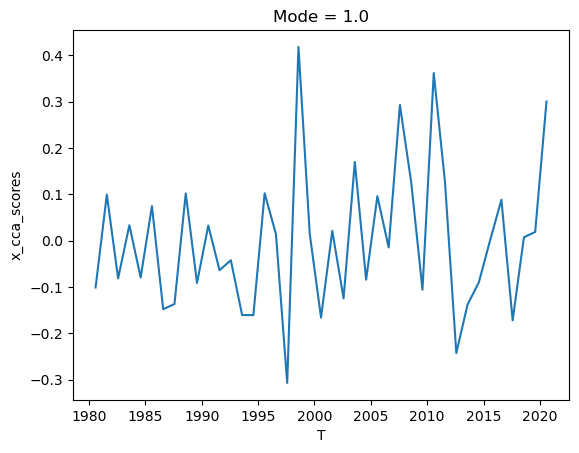

In [167]:
patterns_x.x_cca_scores.sel(Mode=1).plot()

In [169]:
np.corrcoef(patterns_y.y_cca_scores.sel(Mode=1).values, patterns_x.x_cca_scores.sel(Mode=1).values)


array([[1.        , 0.67351284],
       [0.67351284, 1.        ]])

In [170]:
np.corrcoef(x_cca[:,0], y_cca[:,0])

array([[1.        , 0.67272567],
       [0.67272567, 1.        ]])

In [171]:
np.corrcoef(x_cca[:,0], patterns_y.y_cca_scores.sel(Mode=1).values)

array([[1.        , 0.65221673],
       [0.65221673, 1.        ]])